## Notebook Requirements

In [ ]:
!pip install tensorflow_io
!apt-get install rar

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 25.9 MB 4.1 MB/s 
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
The following NEW packages will be installed:
  rar
0 upgraded, 1 newly installed, 0 to remove and 49 not upgraded.
Need to get 295 kB of archives.
After this operation, 799 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/multiverse amd64 rar amd64 2:5.5.0-1 [295 kB]
Fetched 295 kB in 1s (279 kB/s)
Selecting previously unselected package rar.
(Reading database ... 155639 files and directories currently installed.)
Preparing to unpack .../rar_2%3a5.5.0-1_amd64.deb ...
Unpacking rar (2:5.5.0-1) ...
Setting up rar (2:5.5.0-1) ...
Processing triggers for man-db (2.8.3-2

In [ ]:
import os
from os import path
from google.colab import drive
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random

from tqdm import tqdm
from IPython.display import Audio, display
import IPython
from IPython import display
import librosa
import librosa.display
import soundfile as sf
from heapq import merge
from itertools import chain
from collections import namedtuple
import re
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_io as tfio

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
drive.mount('/content/drive')
if os.path.exists('/content/Data') == False:
  os.mkdir("/content/Data/")
  !unrar x "/content/drive/MyDrive/Autism Detection/Data/Autism/Cry sounds.rar" "/content/Data"

Mounted at /content/drive

UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/drive/MyDrive/Autism Detection/Data/Autism/Cry sounds.rar

Creating    /content/Data/Cry sounds                                  OK
Creating    /content/Data/Cry sounds/cleaned                          OK
Creating    /content/Data/Cry sounds/cleaned/ASD1                     OK
Extracting  /content/Data/Cry sounds/cleaned/ASD1/1_1.wav                  0%  OK 
Extracting  /content/Data/Cry sounds/cleaned/ASD1/1_2.wav                  0%  OK 
Extracting  /content/Data/Cry sounds/cleaned/ASD1/2_1.wav                  0%  OK 
Extracting  /content/Data/Cry sounds/cleaned/ASD1/3_1.wav                  0%  OK 
Extracting  /content/Data/Cry sounds/cleaned/ASD1/3_2.wav                  0%  OK 
Extracting  /content/Data/Cry sounds/cleaned/ASD1/3_3.wav                  0%  OK 
Extracting  /content/Data/Cry sounds/cleaned/ASD1/

In [ ]:
@tf.function
def load_wav_16k_mono(filename):
    """ Load a WAV file, convert it to a float tensor, resample to 16 kHz single-channel audio. """
    file_contents = tf.io.read_file(filename)
    wav, sample_rate = tf.audio.decode_wav(
          file_contents,
          desired_channels=1)
    wav = tf.squeeze(wav, axis=-1)
    sample_rate = tf.cast(sample_rate, dtype=tf.int64)
    wav = tfio.audio.resample(wav, rate_in=sample_rate, rate_out=16000)
    return wav

@tf.function
def load_wav_mono(filename):
    """ Load a WAV file, convert it to a float tensor, single-channel audio. """
    file_contents = tf.io.read_file(filename)
    wav, sample_rate = tf.audio.decode_wav(
          file_contents,
          desired_channels=1)
    wav = tf.squeeze(wav, axis=-1)
    return wav

# Voice Activity Detection Using Energy Thresholds

In [ ]:
SR = 44100
N_FFT = 2048
HOP_LENGTH = 512
N_MELS = 60
SAMPLE_LENGTH = 0.5 #s
SAMPLE_SIZE = int(np.ceil(SR*SAMPLE_LENGTH))
NOISE_RATIO = 0.25

LABELS = ["ASD", "TD"]

In [ ]:
from heapq import merge
from itertools import chain
from collections import namedtuple

def remaining(intervals, deleted):
    Event = namedtuple('Event', ['position', 'toggle'])

    int_iter = (Event(position=pos, toggle='in_interval') for pos in chain.from_iterable(intervals))
    del_iter = (Event(position=pos, toggle='in_deleted') for pos in chain.from_iterable(deleted))

    state = {'in_interval': False, 'in_deleted': False}
    start = None
    out = []

    for event in merge(int_iter, del_iter):
        state[event.toggle] = not state[event.toggle]
        if state['in_interval'] and not state['in_deleted']:
            # start a new interval
            start = event.position
        elif start is not None:
            # end an interval. If it's not empty, we append it to the output
            if event.position > start:
                out.append((start, event.position))
            start = None
    return out

In [ ]:
def oneseq (a,n):
    idx = [i for i, v in enumerate(a)  if not i or a[i-1] != v] + [len(a)]
    res= [r for r in zip(idx, idx[1:]) if r[1] >= r[0]+n]
    for ele in res:
      if a[ele[0]] ==0 :
        res.remove(ele)
    return res

def write_ones(one_intervals, original_duration, length):
  res = []
  with open('/content/Data/times.txt', 'w') as writefile:
    for ele in one_intervals:
        # print(line)
        writefile.write(str(ele[0]/length*original_duration) +',' +str((ele[1]-1)/length*original_duration) + '\n')
        res.append((ele[0]/length*original_duration,(ele[1]-1)/length*original_duration))
  return res


def calc_diff(list1,list2):

  rem1 = remaining(list1, list2)
  rem2 = remaining(list2, list1)
  s1 = 0
  s2 = 0
  for i in range(len(rem1)):
    s1 = s1 + rem1[i][1] - rem1[i][0]

  for i in range(len(rem2)):
    s2  = s2 + rem2[i][1] - rem2[i][0]

  return s1, s2

In [ ]:
def read_file(e):
  with open(e, "r") as file1:
    FileList = file1.readlines()

  res = []
  for i in range(len(FileList)):
    res.append((float(FileList[i].split(',')[0]), float((FileList[i].split(',')[1]).split('\n')[0])))
  return res

In [ ]:
SILENCE = 0.01
SILENCE_DOWN = 0.007
global deleted
deleted = []

In [ ]:
def envelope(signal, rate, thresh):
    mask = []
    y = pd.Series(signal).apply(np.abs)
    y_mean = y.rolling(window=int(rate/20), min_periods=1, center=True).mean()
    for i in range(len(y_mean)):
      mask.append((y_mean[i] > thresh) or (y_mean[i] > SILENCE_DOWN and y_mean[i] < thresh and ((i > 0 and y_mean[i-1] > SILENCE_DOWN )  or (i < len(y_mean)-1 and y_mean[i+1] > SILENCE_DOWN ))))
    return mask

def load_audio(root, name):
    path = os.path.join(root, name)
    global diff
    signal, rate = librosa.load(path, sr=SR)
    original_duration = librosa.get_duration(y=signal, sr=rate)


    mask = envelope(signal, rate, SILENCE)
    one_intervals = oneseq(mask, 0)
    # print(one_intervals)
    # energy_intervals =write_ones(one_intervals, original_duration,len(mask))
    # our_intervals = read_file('/content/drive/MyDrive/cry_samples/ASD21-5.txt')
    # a,b = calc_diff(energy_intervals,our_intervals)
    # print("First Percentage: ", a*100/original_duration)
    # print("First Percentage: ", b*100/original_duration)
    # print("Total Percentage: ", a*100/original_duration + b*100/original_duration)

    signal = signal[mask]
    if not os.path.exists(root.replace('original' , 'processed')):
      os.mkdir(root.replace('original' , 'processed'))
    sf.write(path.replace('original' , 'processed'), signal, rate)
    return signal

In [ ]:
root = './Data/Cry sounds/original'
if path.exists("/content/Data/Cry sounds/processed"):
  shutil.rmtree("/content/Data/Cry sounds/processed")
if not path.exists("/content/Data/Cry sounds/processed"):
  os.mkdir("/content/Data/Cry sounds/processed")
for root, directories, files in os.walk(root, topdown=False):
  for name in files:
    testing_wav_file_name = os.path.join(root, name)
    #if root == "./Data/Cry sounds/original/ASD1":
    load_audio(root, name)
    print(testing_wav_file_name, ": Done!")

./Data/Cry sounds/original/ASD24/3.wav : Done!
./Data/Cry sounds/original/ASD24/1.wav : Done!
./Data/Cry sounds/original/ASD24/8.wav : Done!
./Data/Cry sounds/original/ASD24/2.wav : Done!
./Data/Cry sounds/original/ASD24/4.wav : Done!
./Data/Cry sounds/original/ASD24/9.wav : Done!
./Data/Cry sounds/original/ASD24/12.wav : Done!
./Data/Cry sounds/original/ASD24/11.wav : Done!
./Data/Cry sounds/original/ASD24/10.wav : Done!
./Data/Cry sounds/original/ASD24/5.wav : Done!
./Data/Cry sounds/original/ASD24/6.wav : Done!
./Data/Cry sounds/original/ASD24/7.wav : Done!
./Data/Cry sounds/original/ASD14/3.WAV : Done!
./Data/Cry sounds/original/ASD14/8.WAV : Done!
./Data/Cry sounds/original/ASD14/1.wav : Done!
./Data/Cry sounds/original/ASD14/6.WAV : Done!
./Data/Cry sounds/original/ASD14/4.WAV : Done!
./Data/Cry sounds/original/ASD14/5.WAV : Done!
./Data/Cry sounds/original/ASD14/2.wav : Done!
./Data/Cry sounds/original/ASD14/7.WAV : Done!
./Data/Cry sounds/original/TD30/3.WAV : Done!
./Data/Cry 

In [ ]:
!pip uninstall tensorflow
!pip uninstall tensorflow-io
!pip install tensorflow-gpu
!pip install --no-deps tensorflow-io

Found existing installation: tensorflow 2.8.2+zzzcolab20220527125636
Uninstalling tensorflow-2.8.2+zzzcolab20220527125636:
  Would remove:
    /usr/local/bin/estimator_ckpt_converter
    /usr/local/bin/import_pb_to_tensorboard
    /usr/local/bin/saved_model_cli
    /usr/local/bin/tensorboard
    /usr/local/bin/tf_upgrade_v2
    /usr/local/bin/tflite_convert
    /usr/local/bin/toco
    /usr/local/bin/toco_from_protos
    /usr/local/lib/python3.7/dist-packages/tensorflow-2.8.2+zzzcolab20220527125636.dist-info/*
    /usr/local/lib/python3.7/dist-packages/tensorflow/*
Proceed (y/n)? y
  Successfully uninstalled tensorflow-2.8.2+zzzcolab20220527125636
Found existing installation: tensorflow-io 0.26.0
Uninstalling tensorflow-io-0.26.0:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/tensorflow_io-0.26.0.dist-info/*
    /usr/local/lib/python3.7/dist-packages/tensorflow_io/*
Proceed (y/n)? y
  Successfully uninstalled tensorflow-io-0.26.0
Looking in indexes: https://pypi.org/simple,

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached tensorflow_io-0.26.0-cp37-cp37m-manylinux_2_12_x86_64.manylinux2010_x86_64.whl (25.9 MB)


./Data/Cry sounds/processed/ASD12/2.wav
./Data/Cry sounds/original/ASD12/2.wav


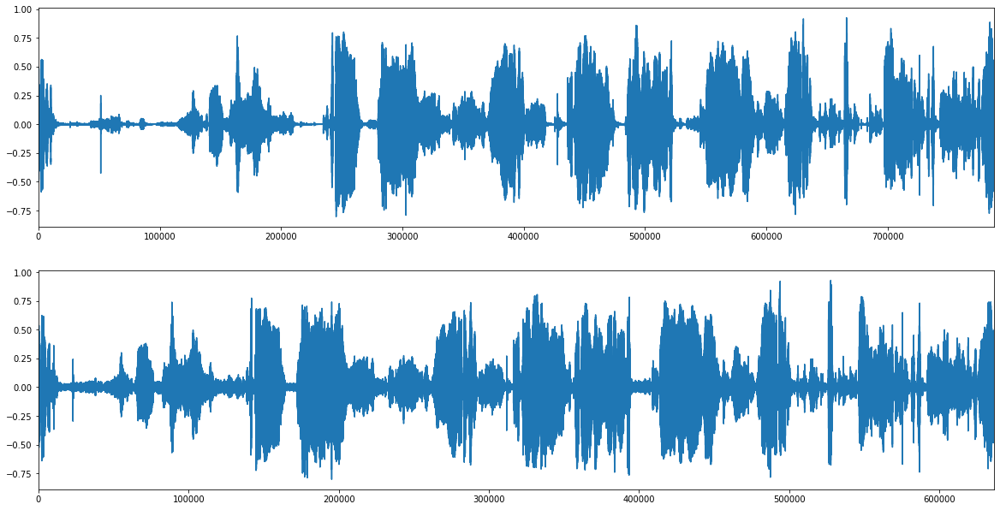

./Data/Cry sounds/processed/ASD12/3.wav
./Data/Cry sounds/original/ASD12/3.wav


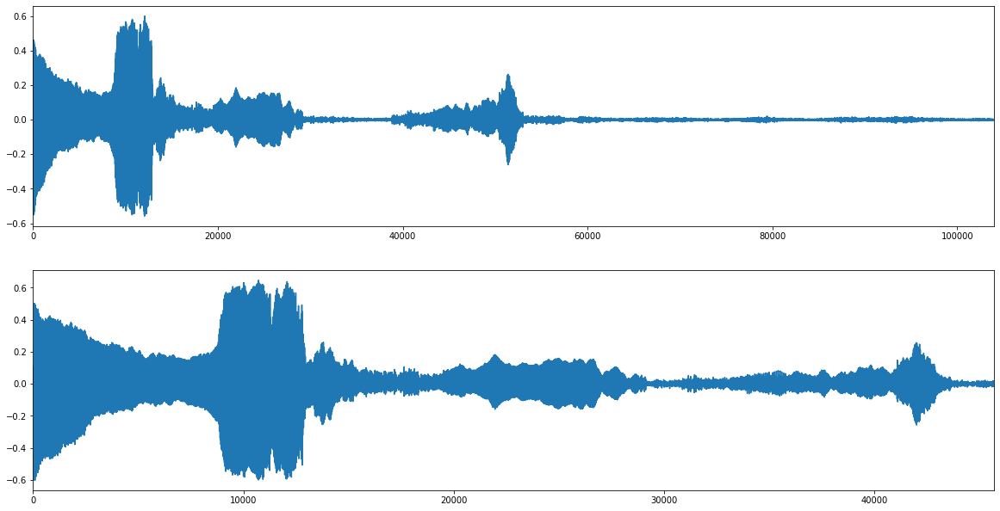

./Data/Cry sounds/processed/ASD12/1.wav
./Data/Cry sounds/original/ASD12/1.wav


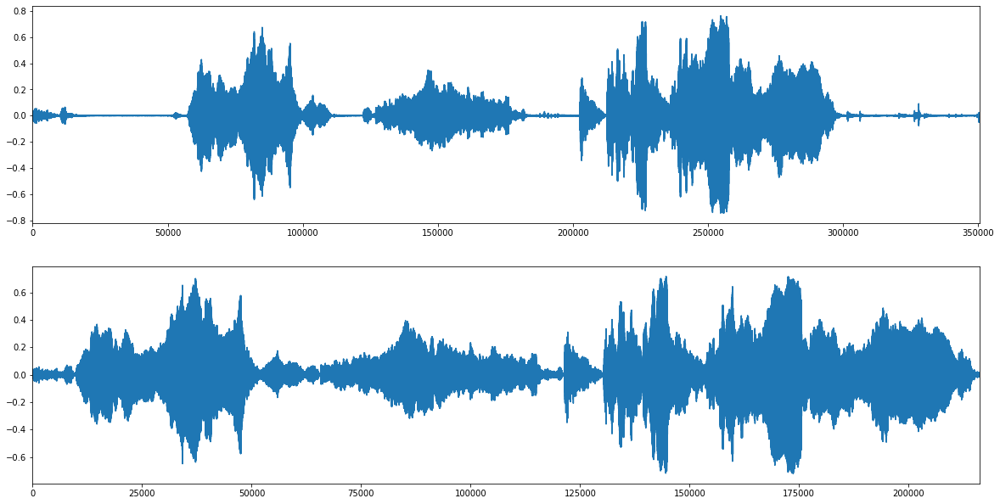

In [ ]:
persons = ['ASD12']
folders = [os.path.join('./Data/Cry sounds/processed', person) for person in persons]
for folder in folders:
  for root, directories, files in os.walk(folder, topdown=False):
    for name in files:
      testing_wav_file_name = os.path.join(root, name)
      print(testing_wav_file_name)
      voice_data = load_wav_16k_mono(testing_wav_file_name)

      plt.figure(figsize=(20, 16))
      plt.subplot(3, 1, 2)
      plt.plot(voice_data)
      plt.xlim([0, len(voice_data)])

      testing_wav_file_name = testing_wav_file_name.replace('processed', 'original')
      print(testing_wav_file_name)
      voice_data = load_wav_16k_mono(testing_wav_file_name)
      plt.subplot(3, 1, 1)
      plt.plot(voice_data)
      plt.xlim([0, len(voice_data)])
      plt.show()

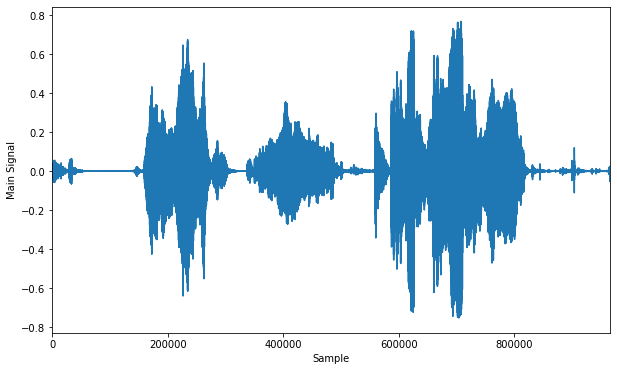

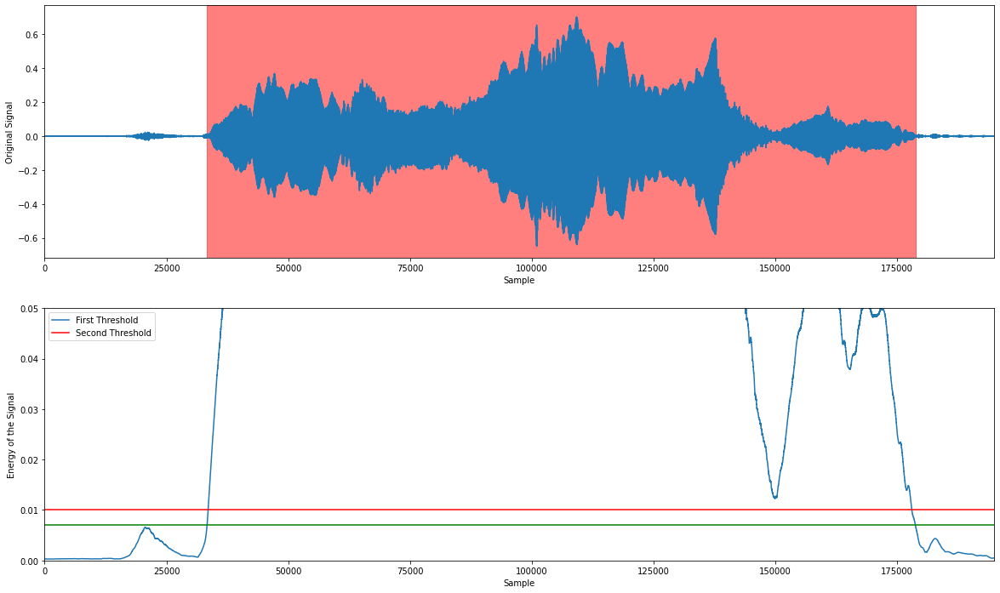

In [ ]:
file_name = './Data/Cry sounds/original/ASD12/1.wav'
signal1= load_wav_mono(file_name)

plt.figure(figsize=(10, 6))
plt.plot(signal1)
plt.xlim([0, len(signal1)])
plt.xlabel('Sample')
plt.ylabel('Main Signal')
plt.savefig('original_signal.png', dpi=300, bbox_inches='tight')
plt.show()

signal1, rate = librosa.load(file_name, sr=SR)
signal2 = signal1[125000:320000]
thresh = SILENCE
mask = []
mask2 = []
mask3 = []
y = pd.Series(signal2).apply(np.abs)
y_mean = y.rolling(window=int(rate/20), min_periods=1, center=True).mean()
for i in range(len(y_mean)):
  mask.append((y_mean[i] > thresh) or (y_mean[i] > SILENCE_DOWN and y_mean[i] < thresh and ((i > 0 and y_mean[i-1] > SILENCE_DOWN )  or (i < len(y_mean)-1 and y_mean[i+1] > SILENCE_DOWN ))))
  mask2.append(y_mean[i] > thresh)
  mask3.append((y_mean[i] > SILENCE_DOWN and y_mean[i] < thresh and ((i > 0 and y_mean[i-1] > SILENCE_DOWN )  or (i < len(y_mean)-1 and y_mean[i+1] > SILENCE_DOWN ))))
# plt.subplot(3, 1, 2)
# plt.plot(mask)
# plt.xlim([0, len(mask)])
# plt.subplot(3, 1, 3)
# plt.plot(mask2)
# plt.xlim([0, len(mask2)])
# plt.subplot(3, 1, 4)
# plt.plot(mask3)
# plt.xlim([0, len(mask3)])

plt.figure(figsize=(20, 12))
signal2 = signal1[125000:320000]
plt.subplot(2, 1, 1)
plt.plot(signal2)
plt.xlim([0, len(signal2)])
plt.xlabel('Sample')
plt.ylabel('Original Signal')
t1 = np.where(np.roll(mask,1)!=mask)[0][0]
t2 = np.where(np.roll(mask,1)!=mask)[0][1]
plt.axvspan(t1, t2, color='red', alpha=0.5)

plt.subplot(2, 1, 2)
plt.plot(y_mean)
plt.xlim([0, len(y_mean)])
plt.ylim([0, 0.05])
plt.xlabel('Sample')
plt.ylabel('Energy of the Signal')
plt.axhline(y = 0.01, color = 'r', linestyle = '-')
plt.axhline(y = 0.007, color = 'g', linestyle = '-')
plt.legend(["First Threshold", "Second Threshold"], loc ="upper left")
plt.savefig('zoomed.png', dpi=300, bbox_inches='tight')
plt.show()

In [ ]:
y2 = y.rolling(window=int(rate/20), min_periods=1, center=True)
y2

Rolling [window=2205,min_periods=1,center=True,axis=0,method=single]

In [ ]:
# if not path.exists("/content/drive/MyDrive/Autism Detection/Data/Autism/processed"):
#   os.mkdir("/content/drive/MyDrive/Autism Detection/Data/Autism/processed")
# !cp -av  "/content/Data/Cry sounds/processed" "/content/drive/MyDrive/Autism Detection/Data/Autism"

'/content/Data/Cry sounds/processed/ASD20' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20'
'/content/Data/Cry sounds/processed/ASD20/19_1.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20/19_1.wav'
'/content/Data/Cry sounds/processed/ASD20/12_11.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20/12_11.wav'
'/content/Data/Cry sounds/processed/ASD20/18_1.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20/18_1.wav'
'/content/Data/Cry sounds/processed/ASD20/14_2.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20/14_2.wav'
'/content/Data/Cry sounds/processed/ASD20/25_2.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20/25_2.wav'
'/content/Data/Cry sounds/processed/ASD20/15_5.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20/15_5.wav'
'/content/Data/Cry sounds/processed/ASD20/29_1.wav' -> '/content/drive/MyDrive

# Clean Cry Detection Using YAMNet

## Initiailization

In [ ]:
yamnet_model_handle = 'https://tfhub.dev/google/yamnet/1'
yamnet_model = hub.load(yamnet_model_handle)
my_classes = ["TD", "ASD"]
class_map_path = yamnet_model.class_map_path().numpy().decode('utf-8')
class_names = list(pd.read_csv(class_map_path)['display_name'])

In [ ]:
if not os.path.exists("/content/Data/Cry sounds/processed"):
  os.mkdir("/content/Data/Cry sounds/processed")
!cp -av "/content/drive/MyDrive/Autism Detection/Data/Autism/processed" "/content/Data/Cry sounds/processed"

'/content/drive/MyDrive/Autism Detection/Data/Autism/processed' -> '/content/Data/Cry sounds/processed/processed'
'/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20' -> '/content/Data/Cry sounds/processed/processed/ASD20'
'/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20/19_1.wav' -> '/content/Data/Cry sounds/processed/processed/ASD20/19_1.wav'
'/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20/14_2.wav' -> '/content/Data/Cry sounds/processed/processed/ASD20/14_2.wav'
'/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20/12_11.wav' -> '/content/Data/Cry sounds/processed/processed/ASD20/12_11.wav'
'/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20/18_1.wav' -> '/content/Data/Cry sounds/processed/processed/ASD20/18_1.wav'
'/content/drive/MyDrive/Autism Detection/Data/Autism/processed/ASD20/15_5.wav' -> '/content/Data/Cry sounds/processed/processed/ASD20/15_5.wav'
'/content/drive/MyDrive/Autism Detecti

## Visualization

./Data/Cry sounds/processed/processed/ASD1/7.wav


The main sound is: Speech
The embeddings shape: (10, 1024)


start: 0 - end: 80039
0.0 5.0024375


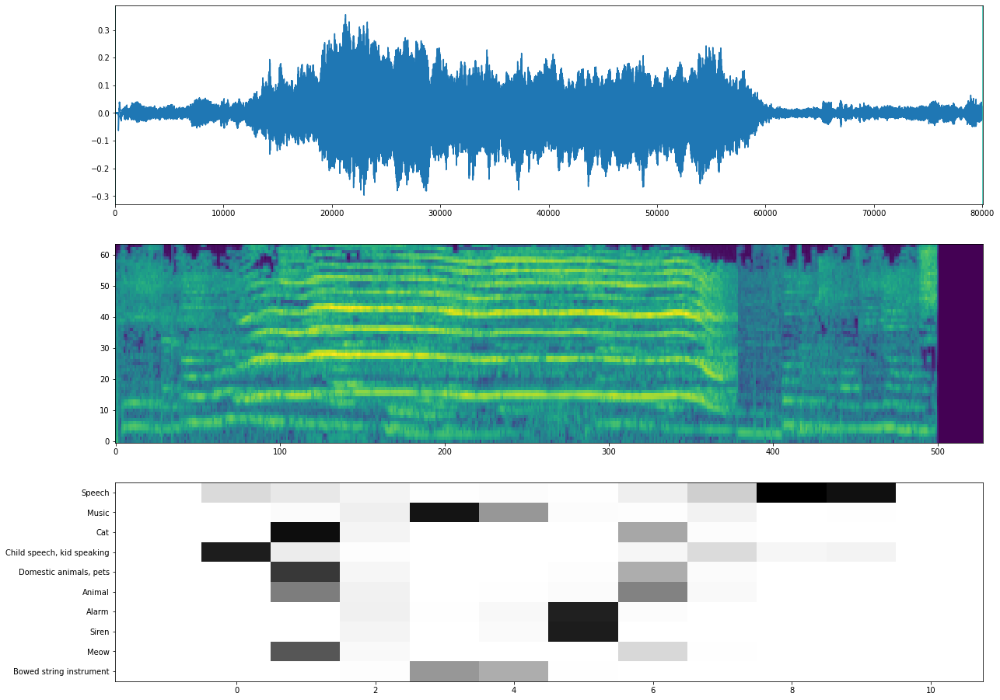

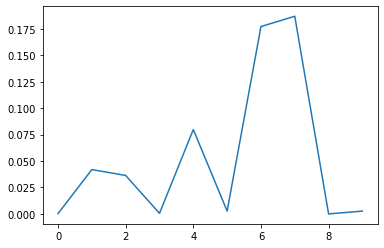

./Data/Cry sounds/processed/processed/ASD1/2.wav


The main sound is: Crying, sobbing
The embeddings shape: (4, 1024)


start: 0 - end: 33213
0.0 2.0758125


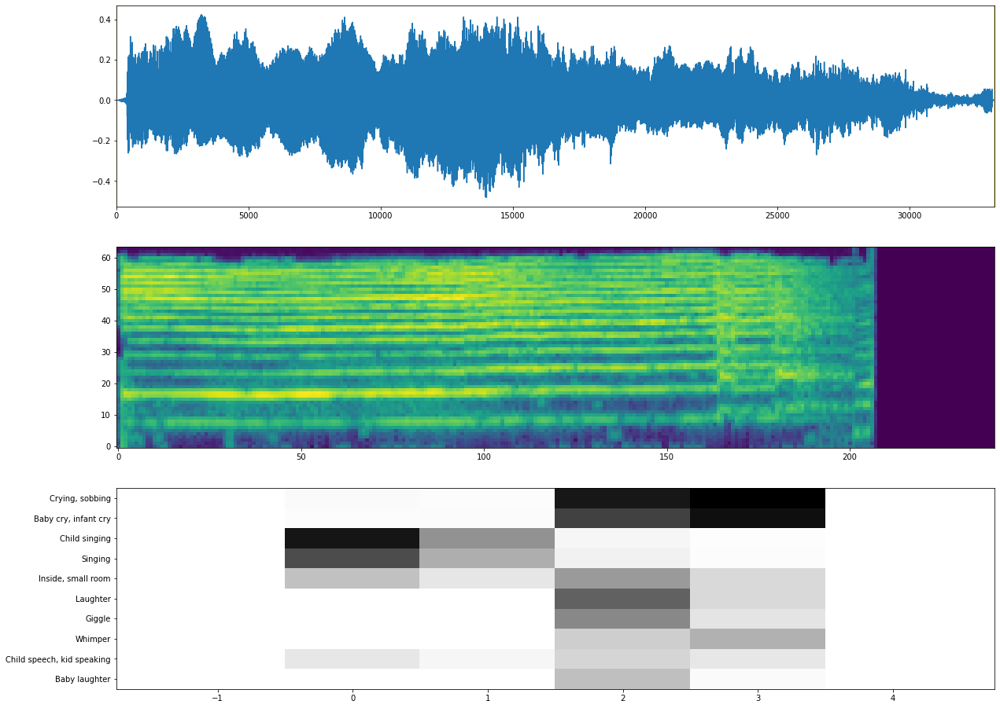

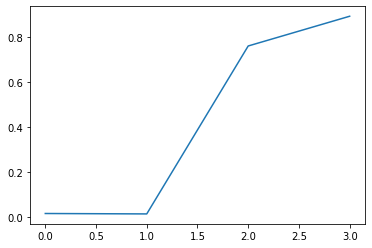

./Data/Cry sounds/processed/processed/ASD1/4.wav


The main sound is: Animal
The embeddings shape: (17, 1024)


start: 0 - end: 132185
0.0 8.2615625


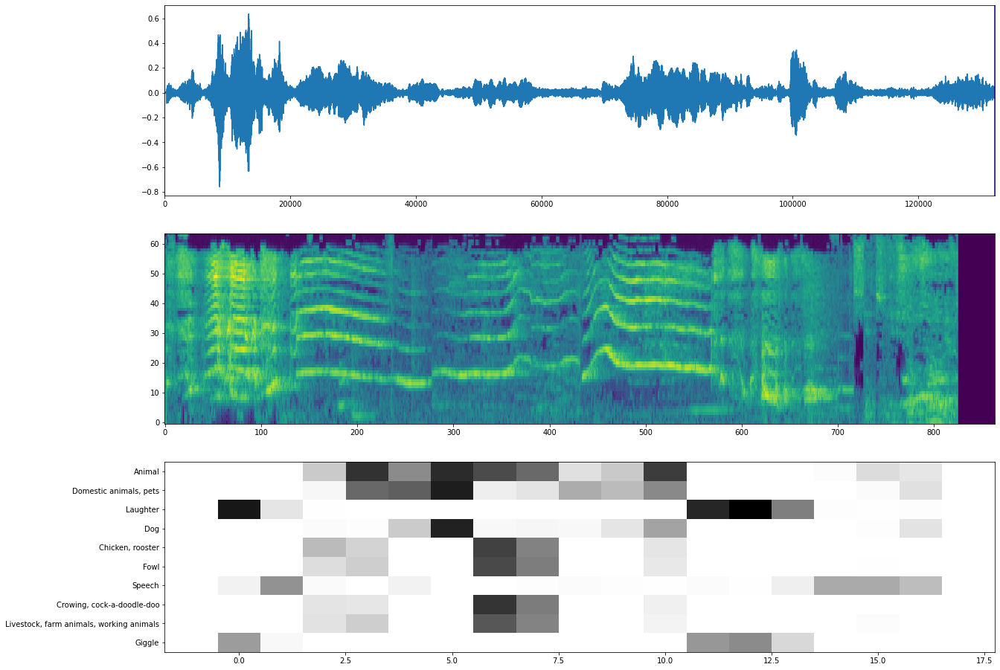

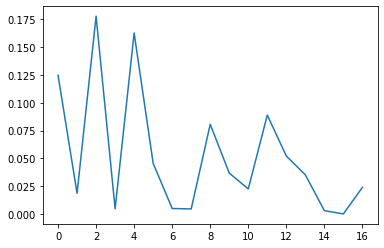

./Data/Cry sounds/processed/processed/ASD1/6.wav


The main sound is: Howl
The embeddings shape: (5, 1024)


start: 0 - end: 44243
0.0 2.7651875


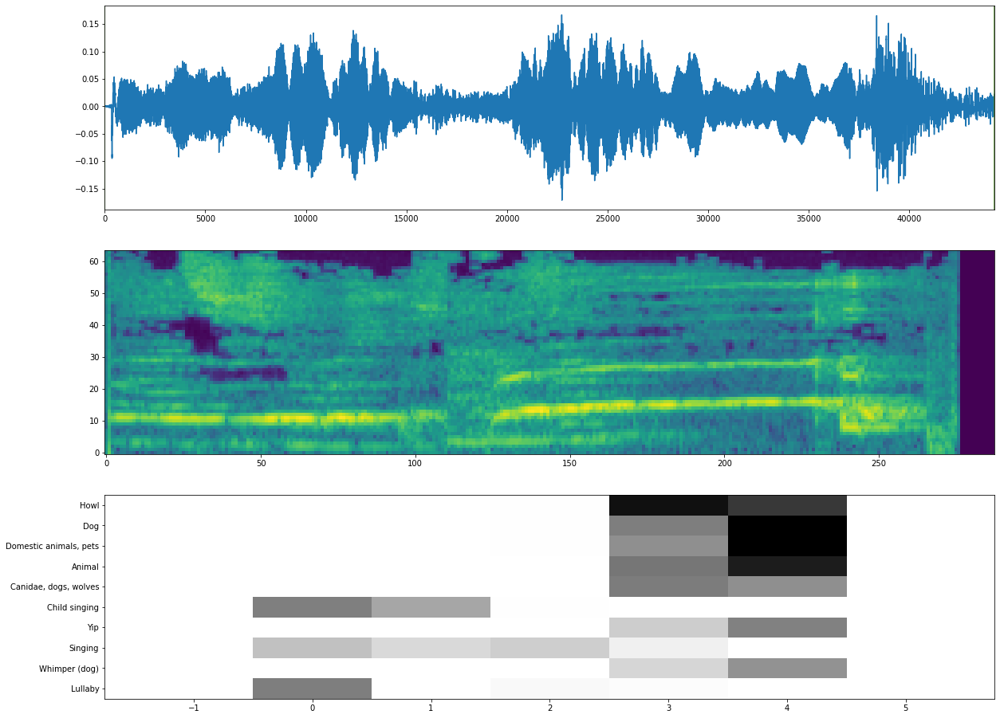

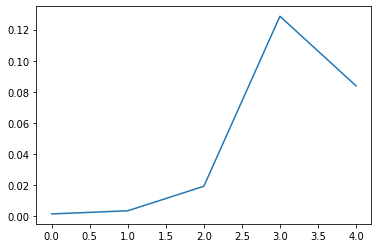

./Data/Cry sounds/processed/processed/ASD1/3.wav


The main sound is: Animal
The embeddings shape: (183, 1024)


start: 0 - end: 1407983
0.0 87.9989375


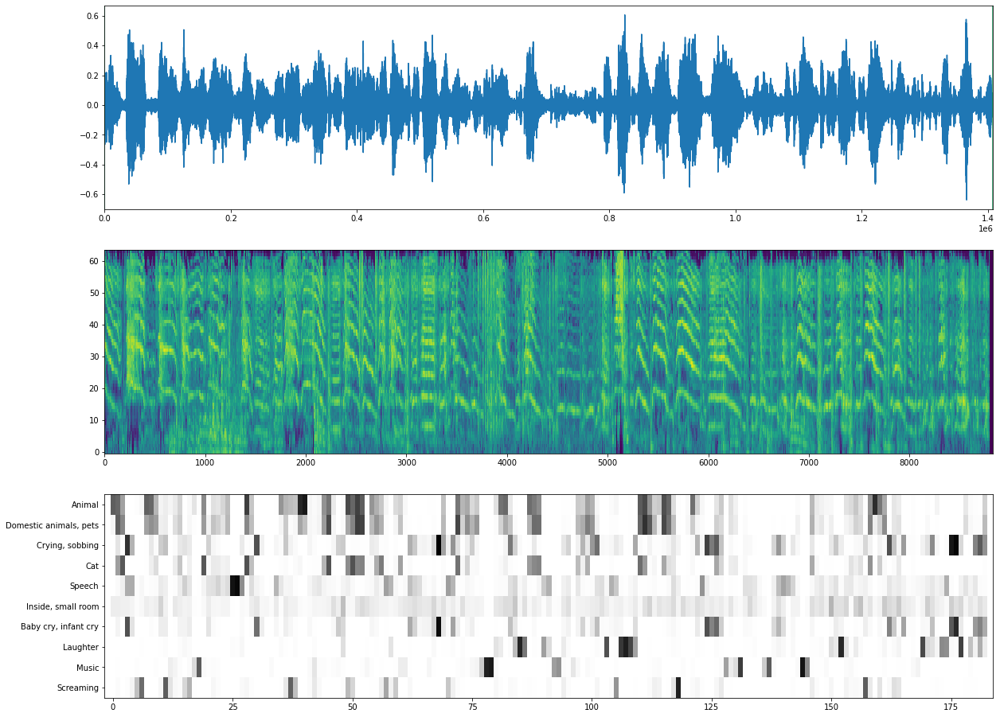

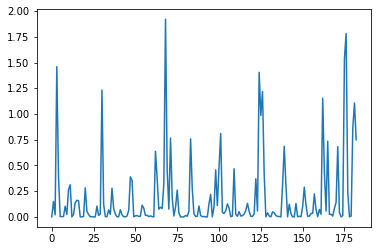

./Data/Cry sounds/processed/processed/ASD1/1.wav


The main sound is: Laughter
The embeddings shape: (35, 1024)


start: 0 - end: 274373
0.0 17.1483125


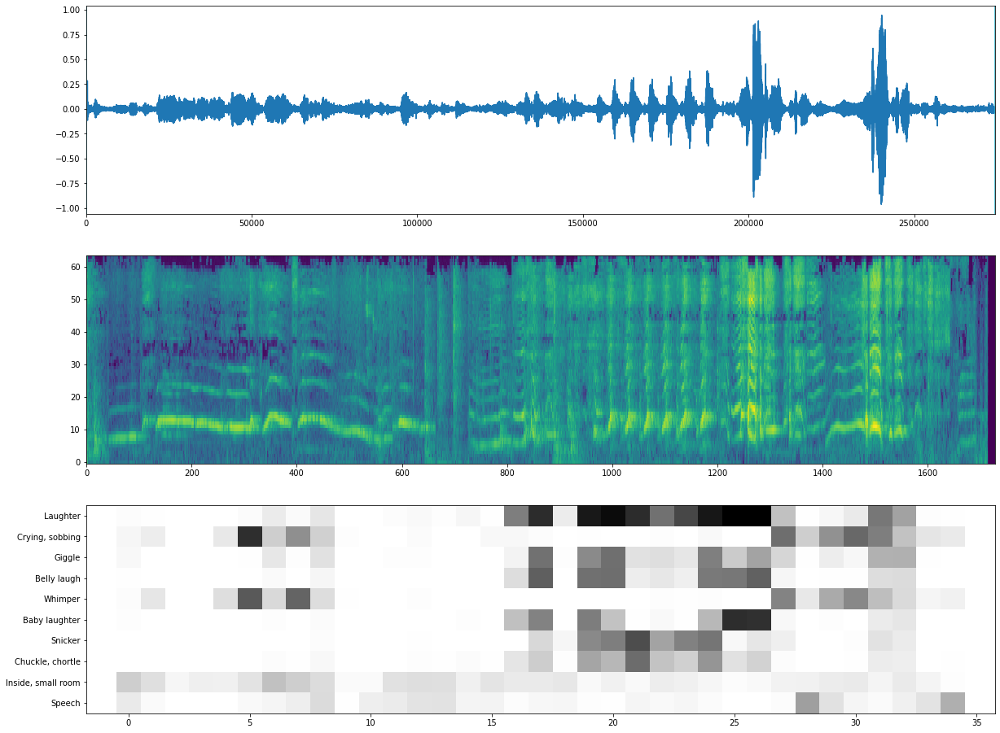

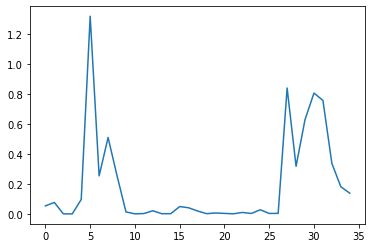

./Data/Cry sounds/processed/processed/ASD1/8.wav


The main sound is: Speech
The embeddings shape: (10, 1024)


start: 0 - end: 80039
0.0 5.0024375


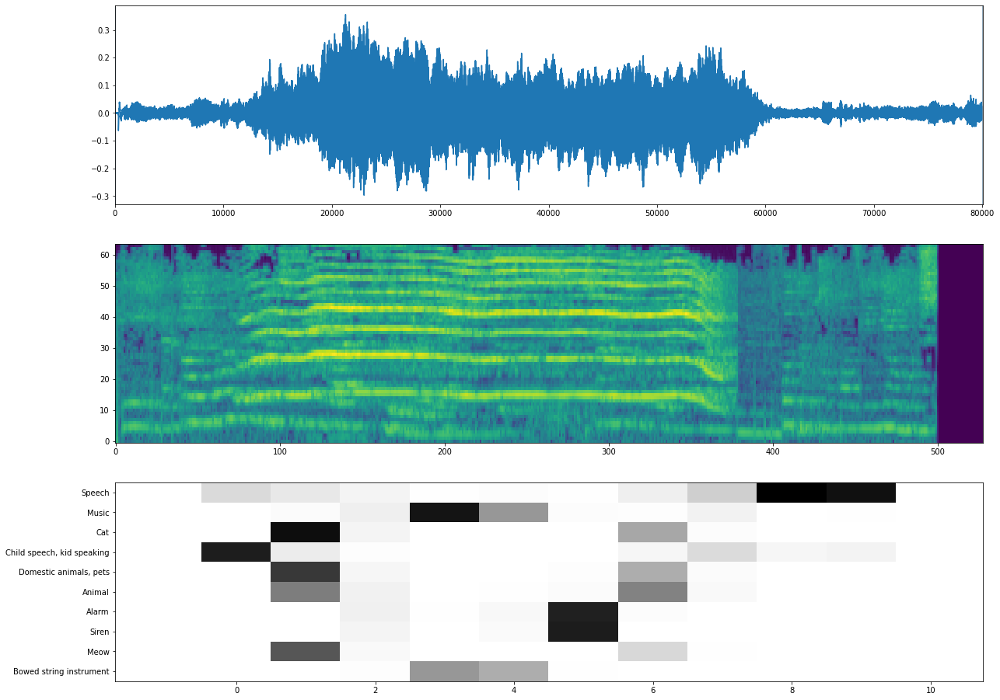

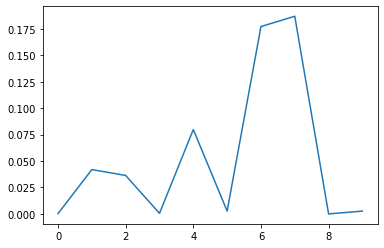

./Data/Cry sounds/processed/processed/ASD1/5.wav


The main sound is: Speech
The embeddings shape: (9, 1024)


start: 0 - end: 76915
0.0 4.8071875


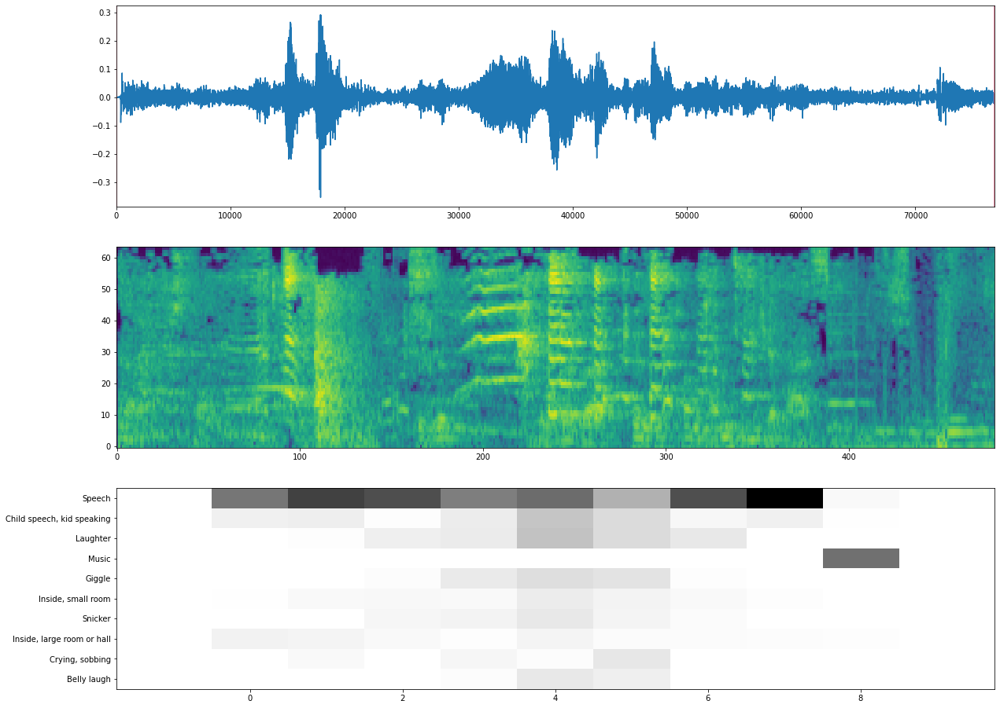

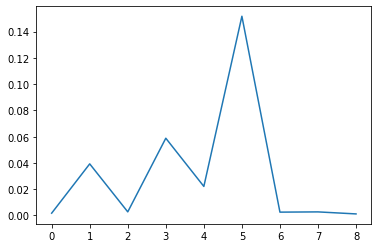

./Data/Cry sounds/processed/processed/ASD7/2.wav


The main sound is: Crying, sobbing
The embeddings shape: (56, 1024)


start: 0 - end: 435389
0.0 27.2118125


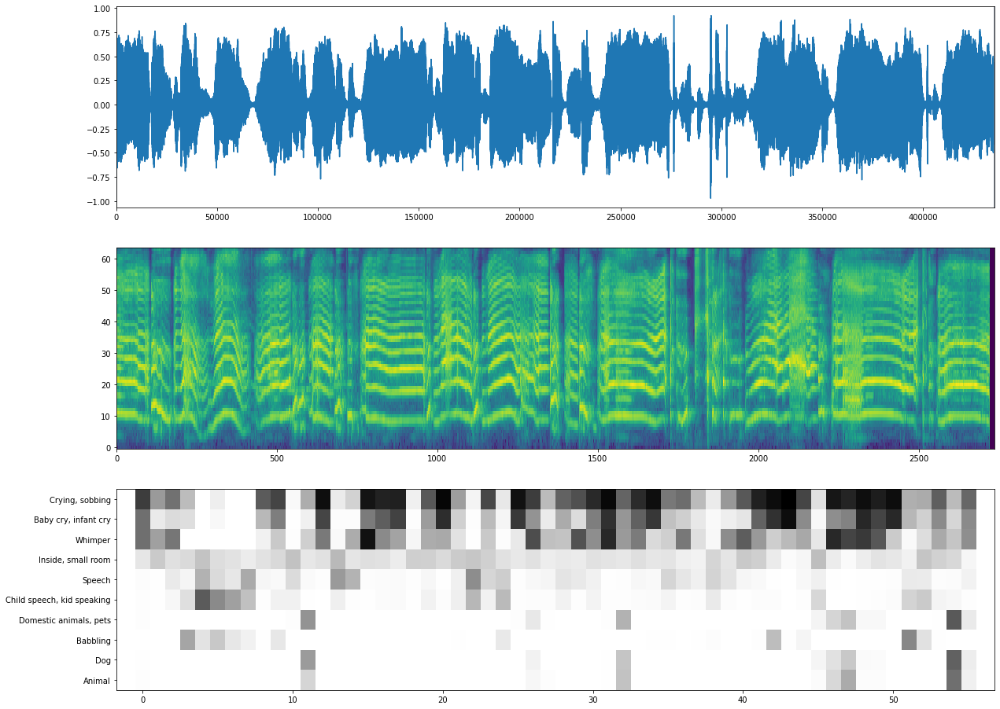

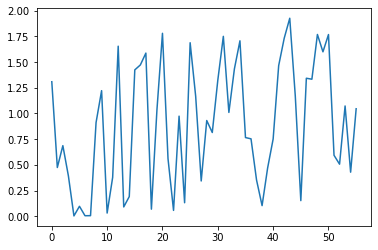

./Data/Cry sounds/processed/processed/ASD7/3.wav


The main sound is: Crying, sobbing
The embeddings shape: (14, 1024)


start: 0 - end: 111023
0.0 6.9389375


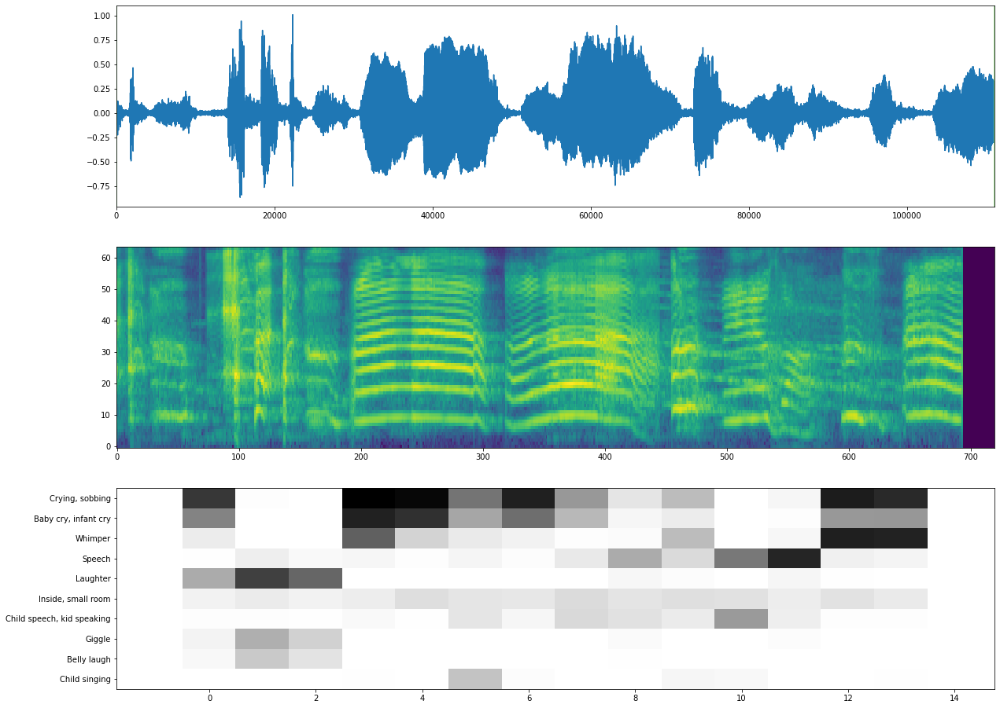

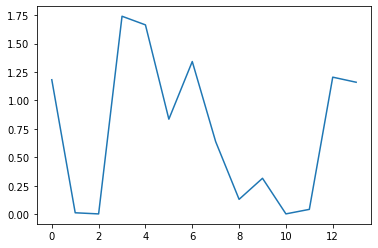

./Data/Cry sounds/processed/processed/ASD7/1.wav


The main sound is: Crying, sobbing
The embeddings shape: (179, 1024)


start: 0 - end: 1378660
0.0 86.16625


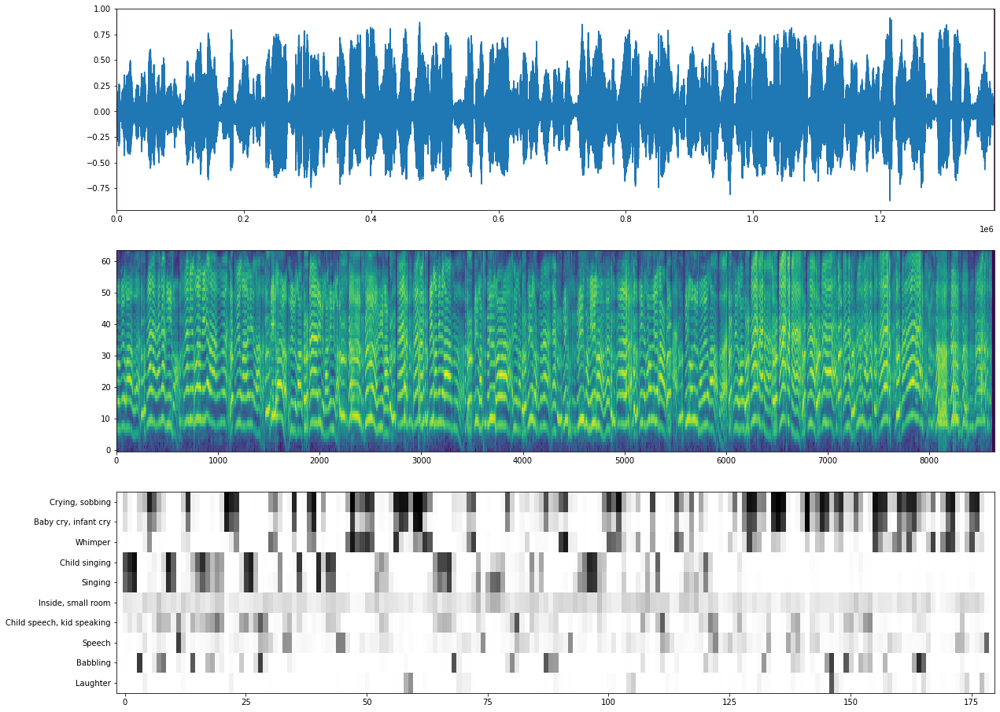

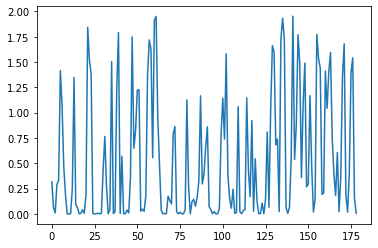

./Data/Cry sounds/processed/processed/ASD11/2.WAV


The main sound is: Domestic animals, pets
The embeddings shape: (87, 1024)


start: 0 - end: 671059
0.0 41.9411875


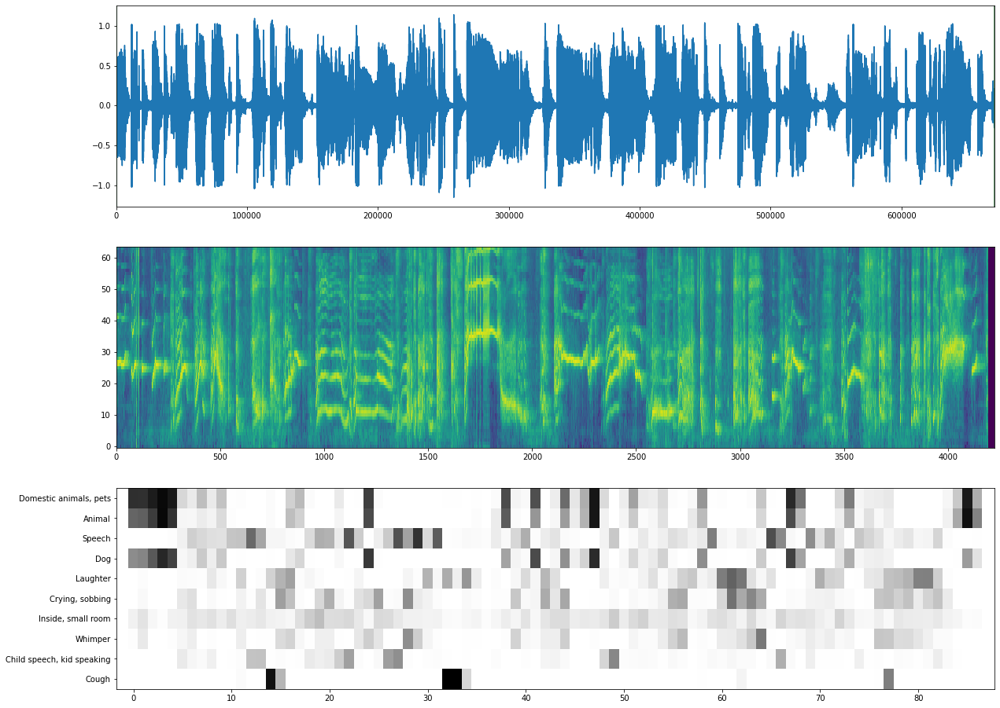

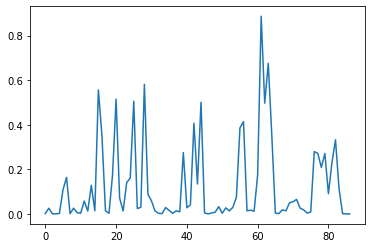

./Data/Cry sounds/processed/processed/ASD11/1.WAV


The main sound is: Speech
The embeddings shape: (17, 1024)


start: 0 - end: 137494
0.0 8.593375


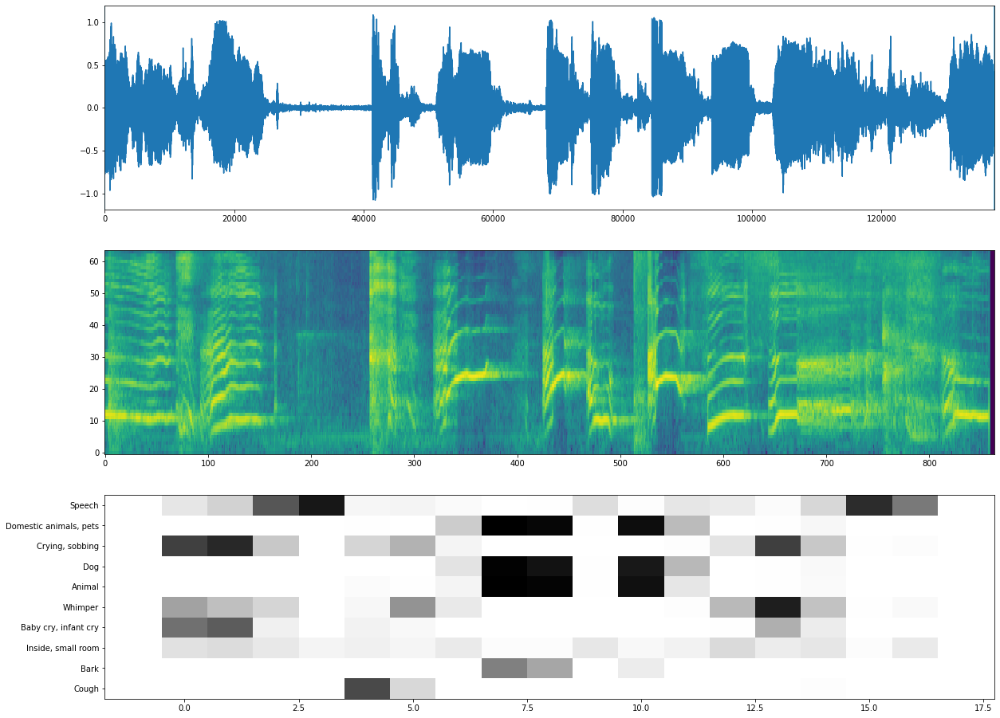

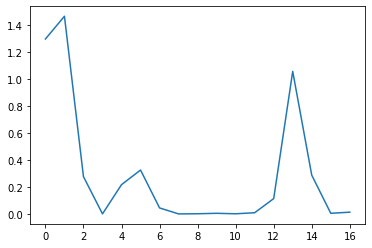

./Data/Cry sounds/processed/processed/ASD11/3.WAV


The main sound is: Speech
The embeddings shape: (71, 1024)


start: 0 - end: 547746
0.0 34.234125


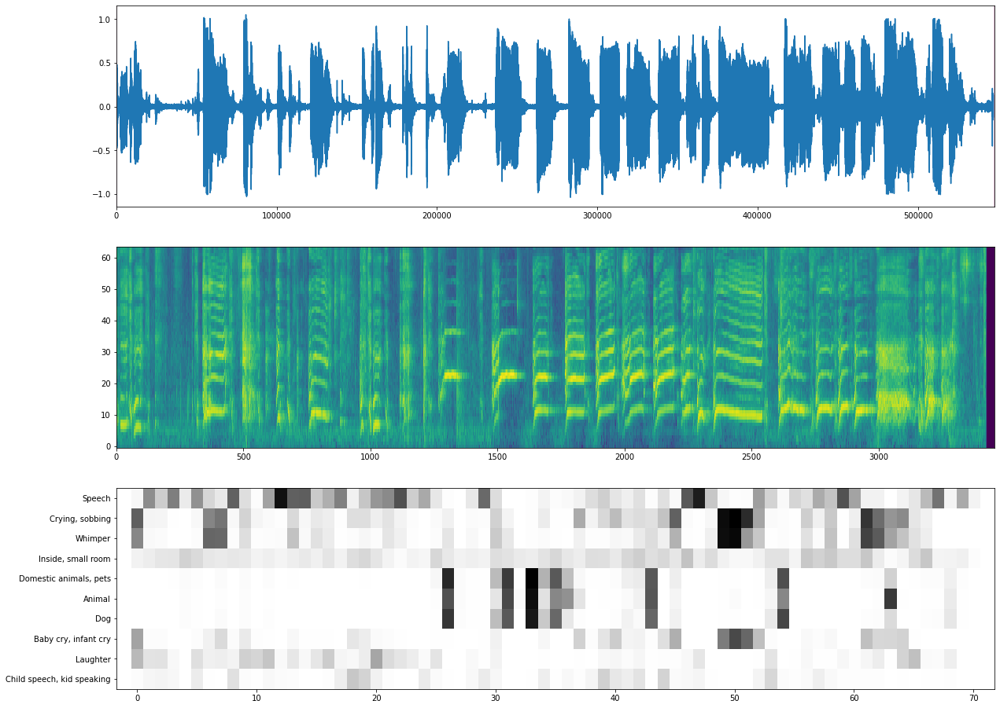

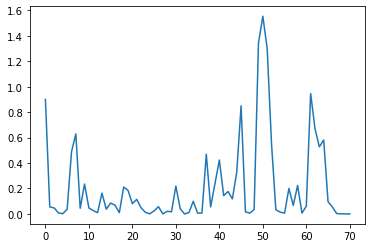

./Data/Cry sounds/processed/processed/ASD11/4.WAV


The main sound is: Crying, sobbing
The embeddings shape: (3, 1024)


start: 0 - end: 24261
0.0 1.5163125


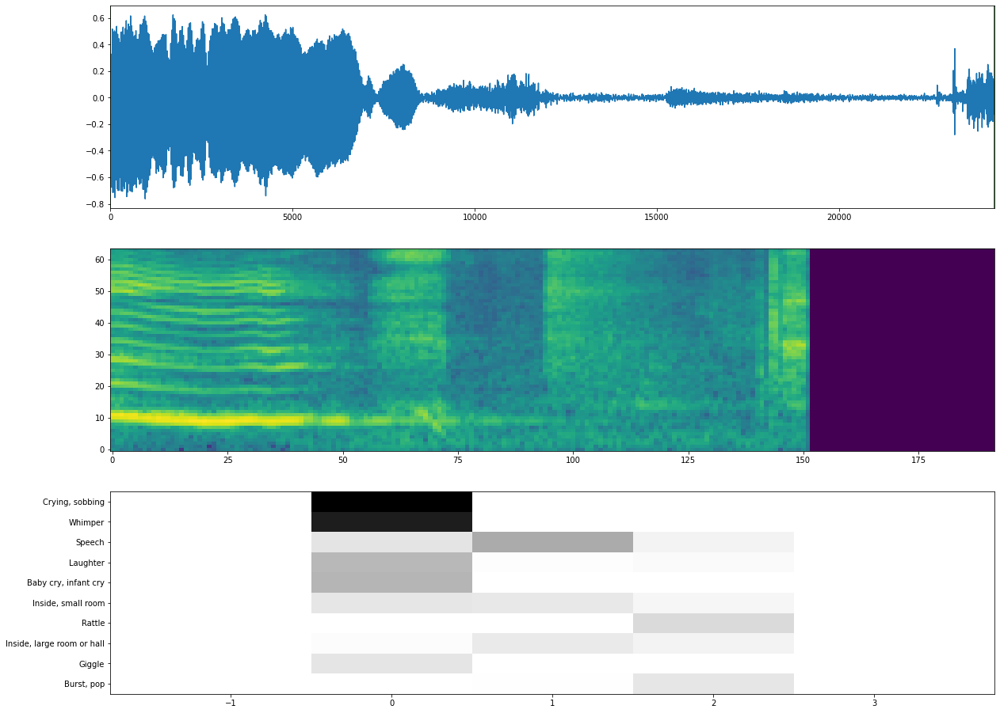

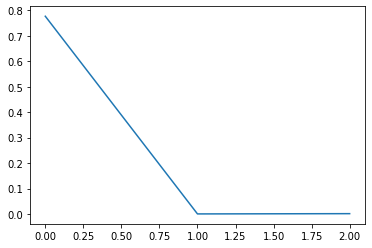

./Data/Cry sounds/processed/processed/ASD11/6.WAV


The main sound is: Speech
The embeddings shape: (6, 1024)


start: 0 - end: 50347
0.0 3.1466875


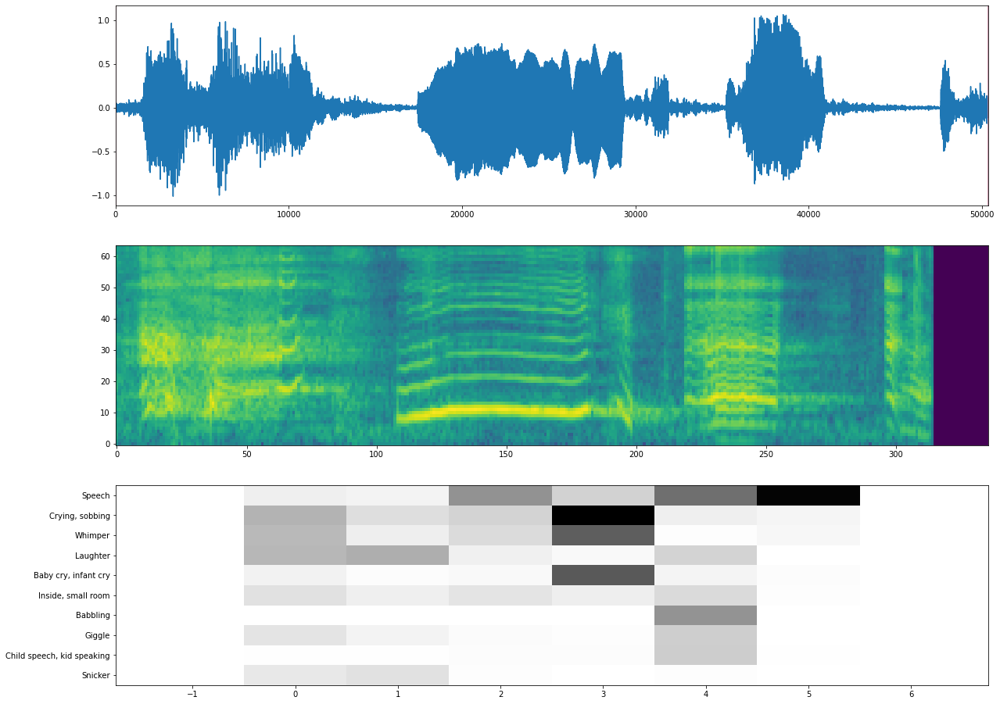

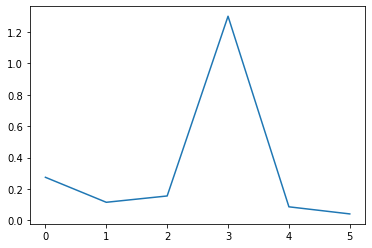

./Data/Cry sounds/processed/processed/ASD11/5.WAV


The main sound is: Domestic animals, pets
The embeddings shape: (31, 1024)


start: 0 - end: 239673
0.0 14.9795625


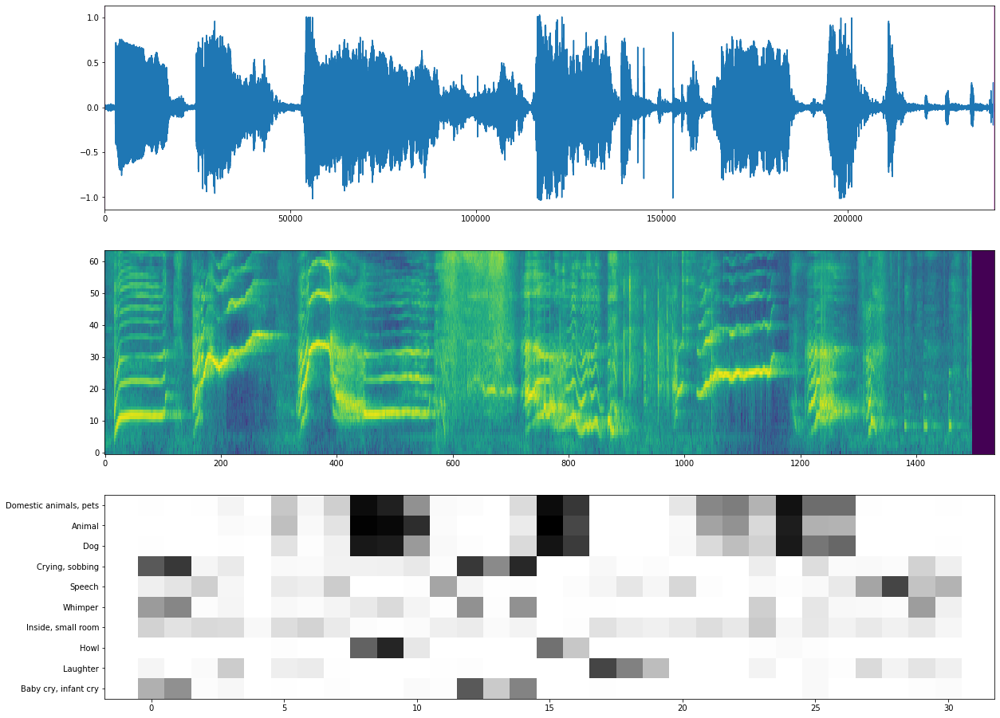

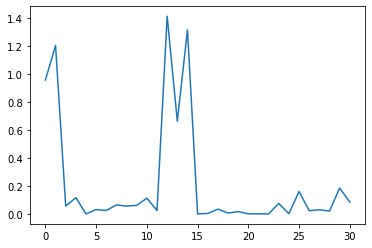

./Data/Cry sounds/processed/processed/ASD21/2.wav


The main sound is: Crying, sobbing
The embeddings shape: (24, 1024)


start: 0 - end: 190248
0.0 11.8905


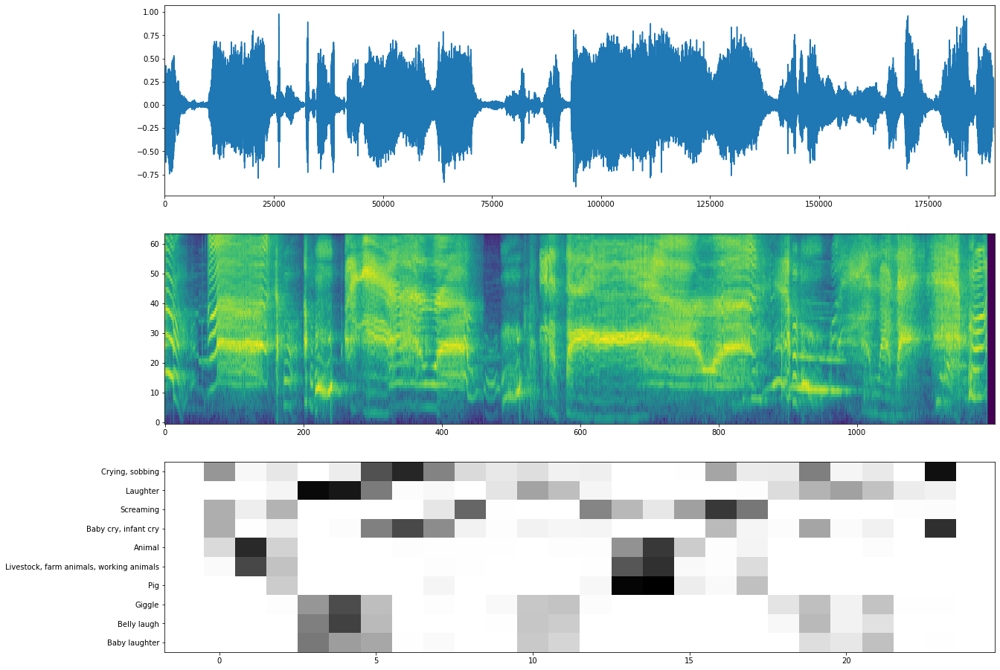

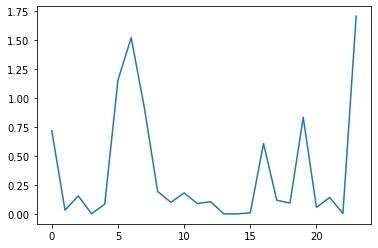

./Data/Cry sounds/processed/processed/ASD21/4.wav


The main sound is: Crying, sobbing
The embeddings shape: (4, 1024)


start: 0 - end: 37258
0.0 2.328625


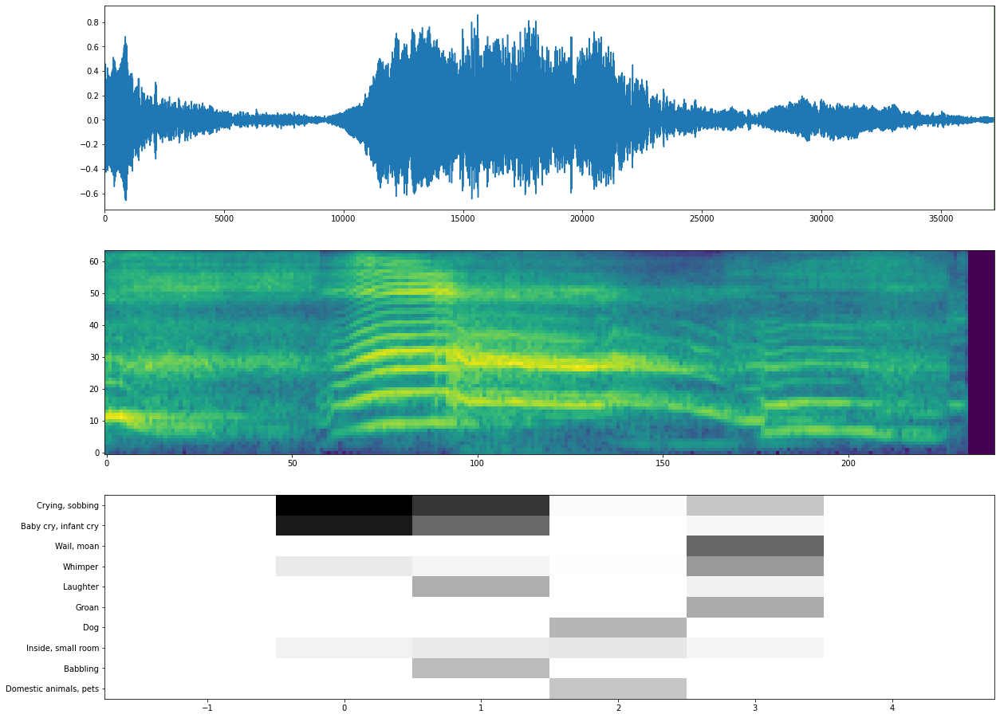

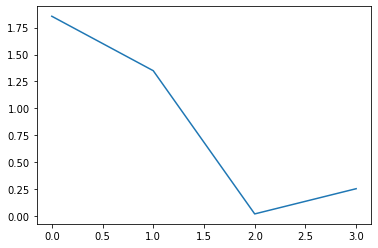

./Data/Cry sounds/processed/processed/ASD21/6.wav


The main sound is: Crying, sobbing
The embeddings shape: (42, 1024)


start: 0 - end: 327673
0.0 20.4795625


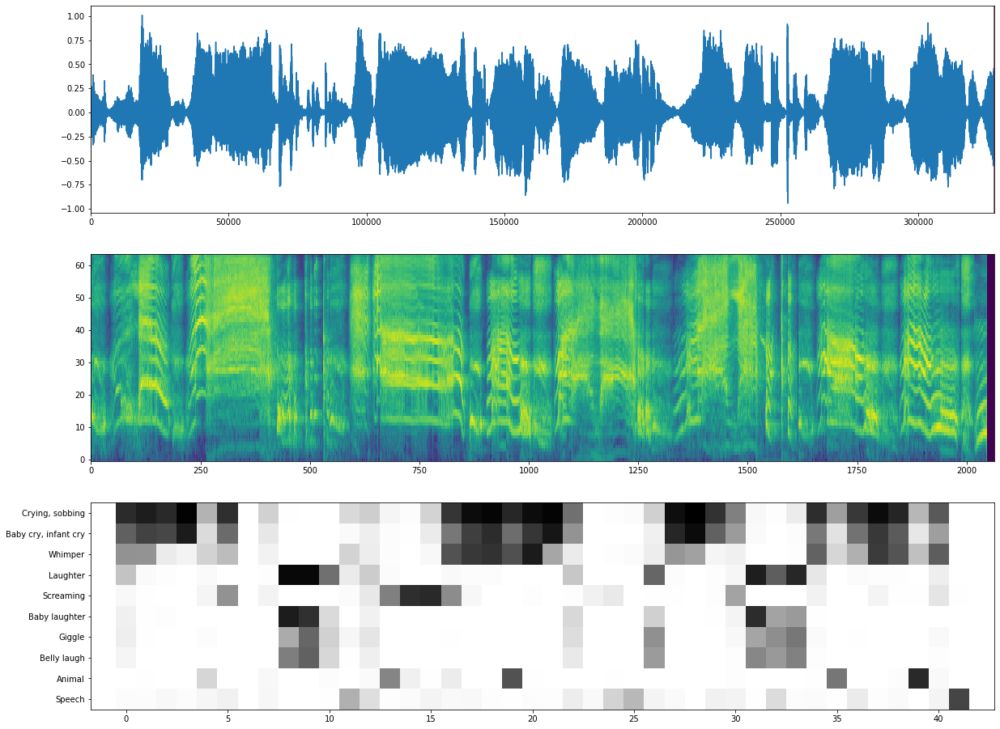

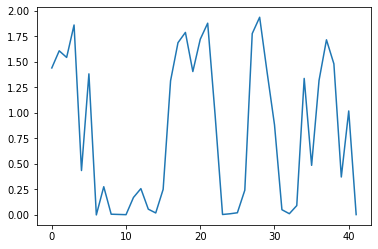

./Data/Cry sounds/processed/processed/ASD21/3.wav


The main sound is: Crying, sobbing
The embeddings shape: (14, 1024)


start: 0 - end: 110549
0.0 6.9093125


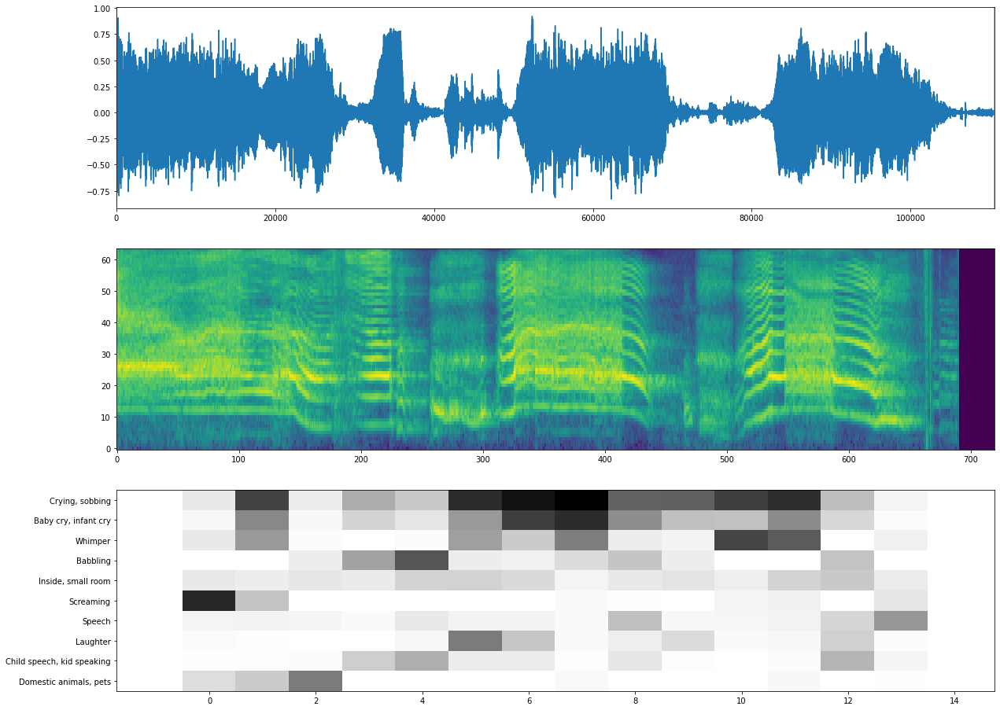

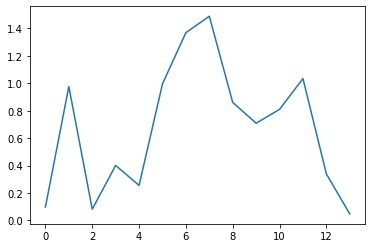

./Data/Cry sounds/processed/processed/ASD21/1.wav


The main sound is: Crying, sobbing
The embeddings shape: (21, 1024)


start: 0 - end: 164512
0.0 10.282


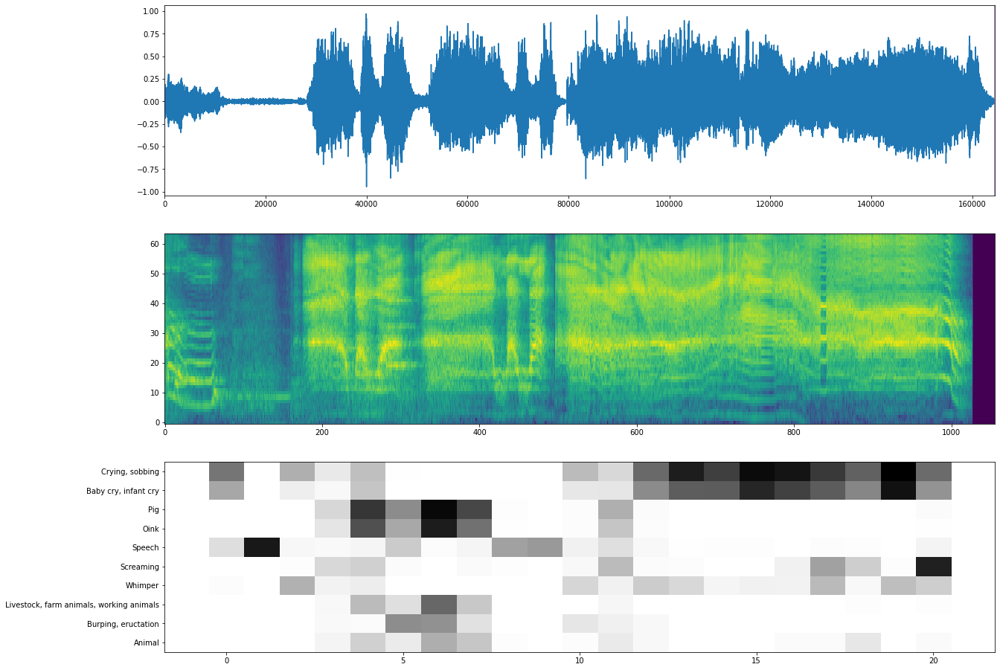

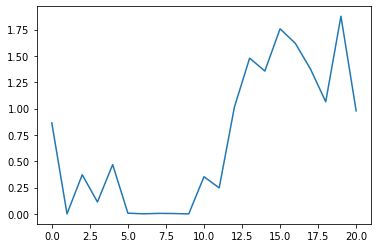

./Data/Cry sounds/processed/processed/ASD21/5.wav


The main sound is: Crying, sobbing
The embeddings shape: (13, 1024)


start: 0 - end: 102906
0.0 6.431625


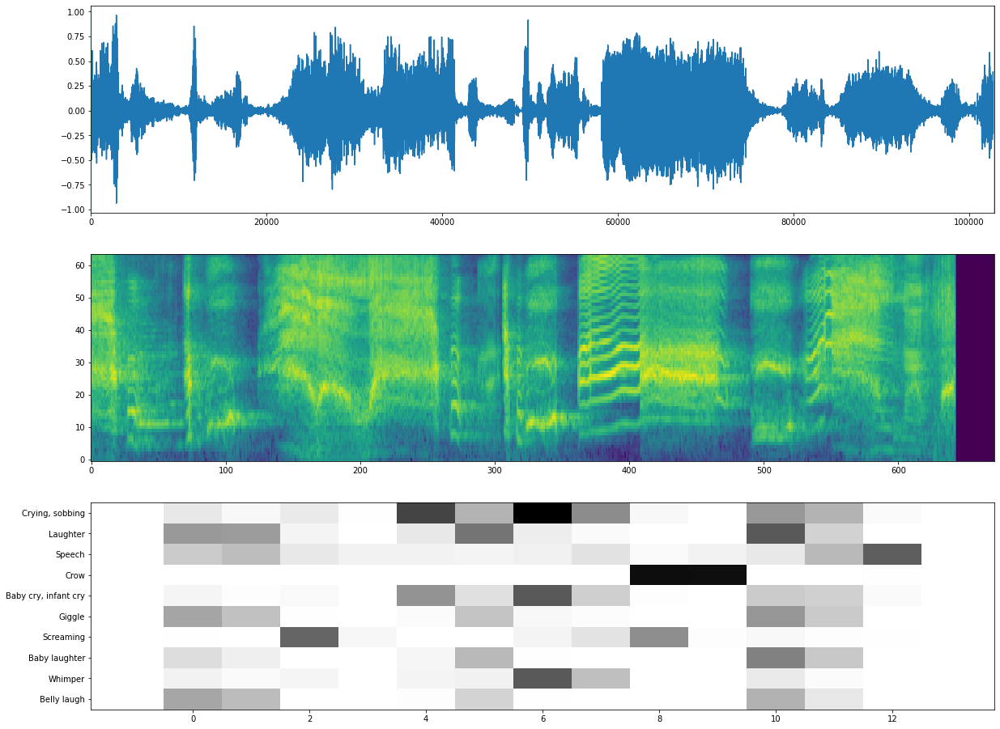

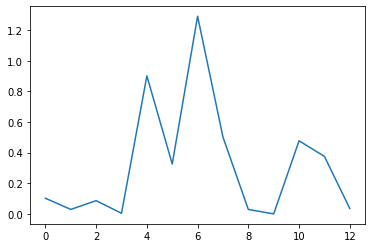

./Data/Cry sounds/processed/processed/TD1/2.WAV


The main sound is: Crying, sobbing
The embeddings shape: (11, 1024)


start: 0 - end: 87787
0.0 5.4866875


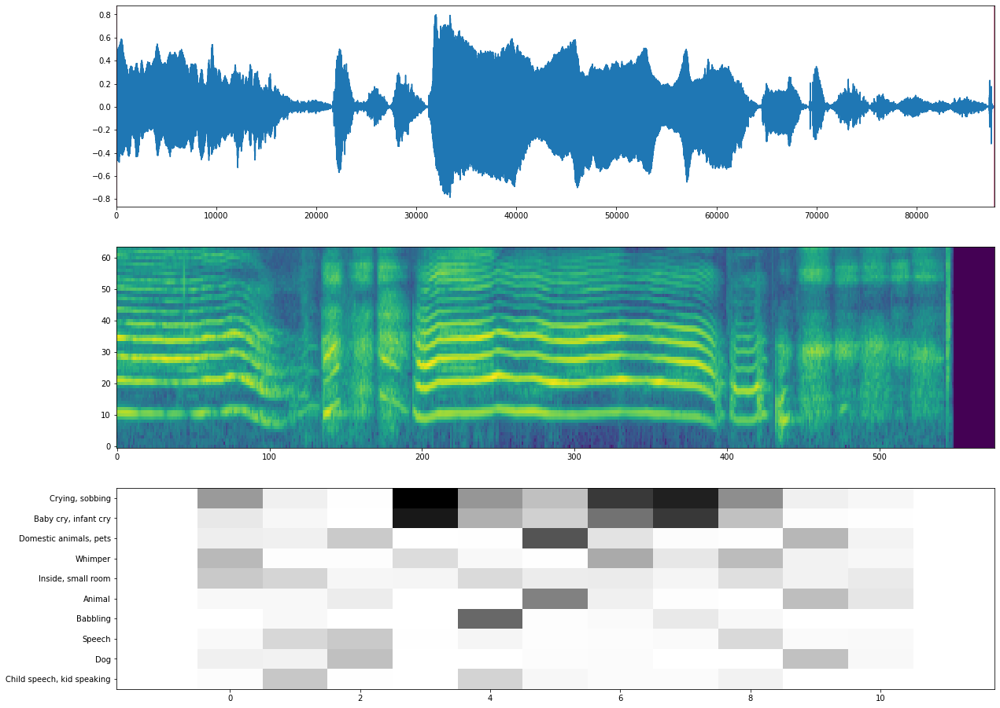

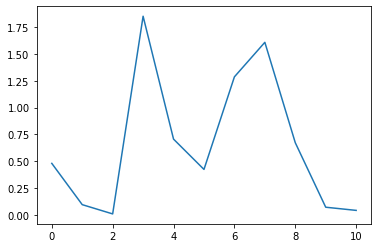

./Data/Cry sounds/processed/processed/TD1/1.WAV


The main sound is: Crying, sobbing
The embeddings shape: (14, 1024)


start: 0 - end: 110016
0.0 6.876


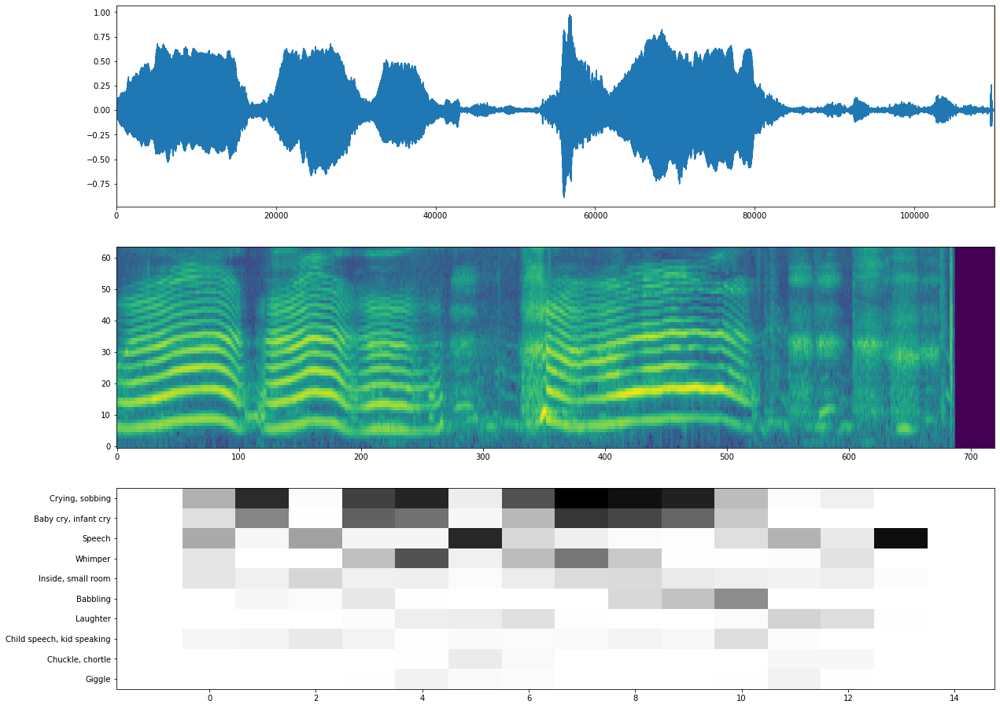

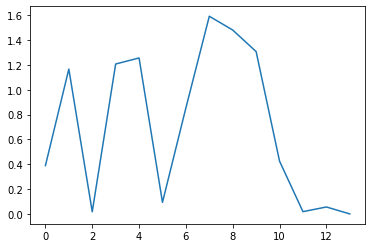

./Data/Cry sounds/processed/processed/TD1/3.WAV


The main sound is: Crying, sobbing
The embeddings shape: (51, 1024)


start: 0 - end: 396020
0.0 24.75125


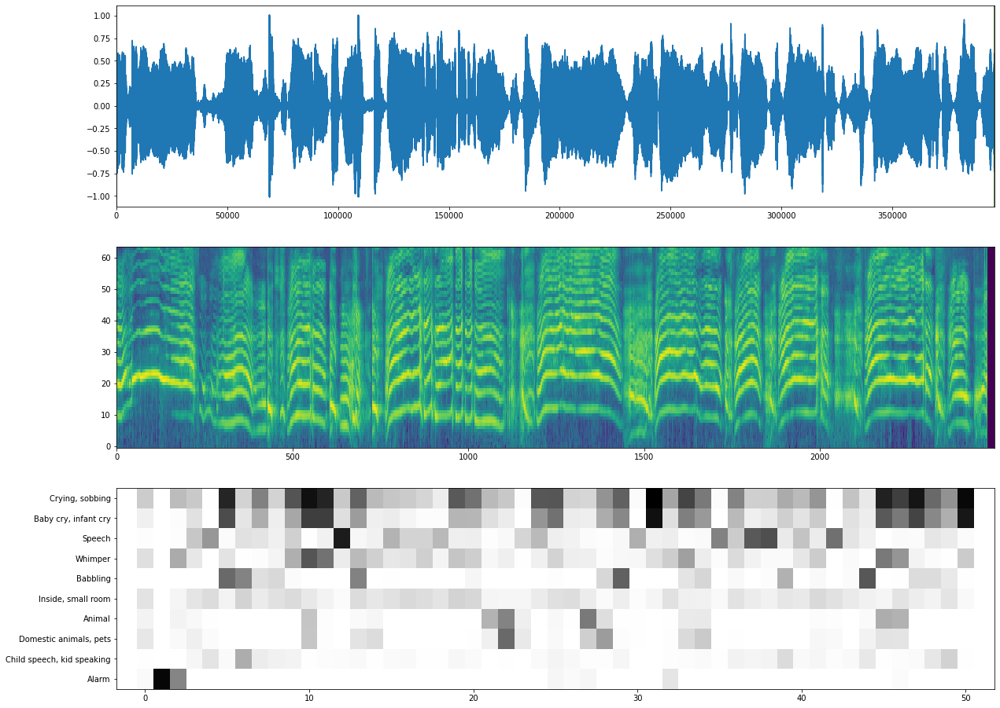

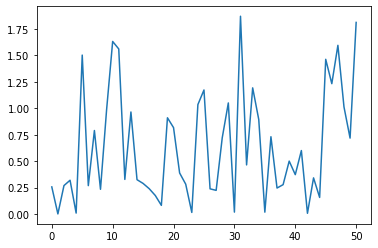

./Data/Cry sounds/processed/processed/TD1/4.WAV


The main sound is: Crying, sobbing
The embeddings shape: (22, 1024)


start: 0 - end: 172425
0.0 10.7765625


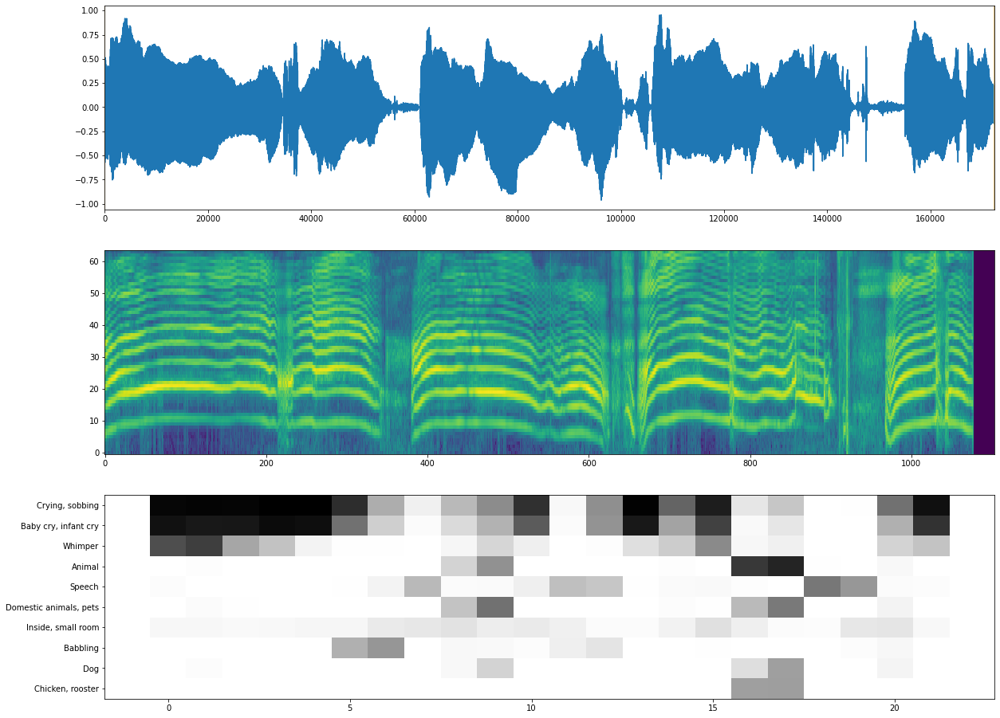

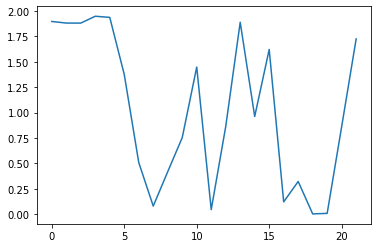

./Data/Cry sounds/processed/processed/TD4/1.wav


The main sound is: Crying, sobbing
The embeddings shape: (49, 1024)


start: 0 - end: 384118
0.0 24.007375


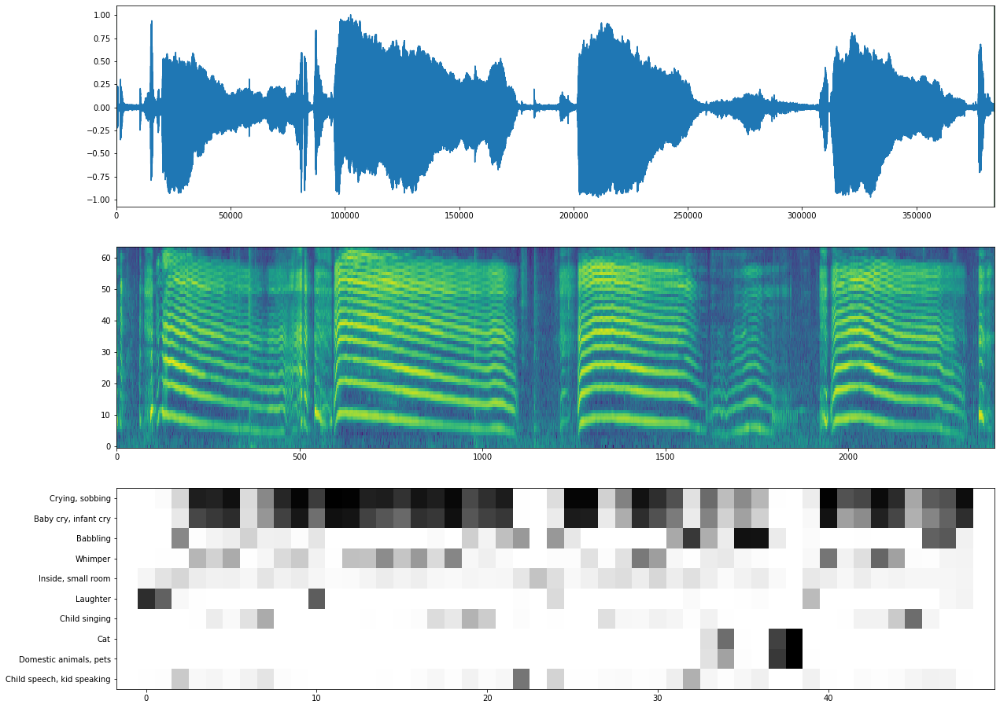

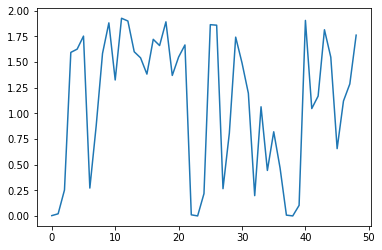

In [ ]:
persons = ['ASD1', 'ASD7', 'ASD11','ASD21', 'TD1', 'TD4']
folders = [os.path.join('./Data/Cry sounds/processed/processed', person) for person in persons]
for folder in folders:
  for root, directories, files in os.walk(folder, topdown=False):
    for name in files:
      testing_wav_file_name = os.path.join(root, name)
      print(testing_wav_file_name)
      wav_data = load_wav_mono(testing_wav_file_name)
      voice_data = load_wav_16k_mono(testing_wav_file_name)
      scores, embeddings, spectrogram = yamnet_model(voice_data)
      class_scores = tf.reduce_mean(scores, axis=0)
      top_class = tf.argmax(class_scores)
      inferred_class = class_names[top_class]

      print(f'The main sound is: {inferred_class}')
      print(f'The embeddings shape: {embeddings.shape}')
      IPython.display.display(IPython.display.Audio(voice_data,rate=16000))
      plt.figure(figsize=(20, 16))

      # Plot the waveform.
      plt.subplot(3, 1, 1)
      plt.plot(voice_data)
      plt.xlim([0, len(voice_data)])
      for root2, directories2, files2 in os.walk(folder.replace("original", "cleaned"), topdown=False):
        for name2 in files2:
          if (name2.split(".")[0])[0] == (name.split(".")[0])[0]:
            segment_data = load_wav_mono(os.path.join(root2, name2))
            indices = np.where(wav_data == segment_data[0])
            for i in indices[0]:
              
              flag = True
              for j in range(10):
                if segment_data[j] != wav_data[i+j]:
                  flag = False
              if flag:
                index = i
                r = random.random()
                b = random.random()
                g = random.random()
                color = (r, g, b)
                start = int(index*(16/44.1))
                end = int((index+len(segment_data))*(16/44.1))
                print("start:", start, "- end:", end)
                print(start/16000, end/16000)
                plt.axvline(x=start, color=color)
                plt.axvline(x=end, color=color)
                break
      # Plot the log-mel spectrogram (returned by the model).
      plt.subplot(3, 1, 2)
      plt.imshow(spectrogram.numpy().T, aspect='auto', interpolation='nearest', origin='lower')

      # Plot and label the model output scores for the top-scoring classes.
      mean_scores = np.mean(scores, axis=0)
      top_n = 10
      top_class_indices = np.argsort(mean_scores)[::-1][:top_n]
      plt.subplot(3, 1, 3)
      plt.imshow(scores.numpy()[:, top_class_indices].T, aspect='auto', interpolation='nearest', cmap='gray_r')

      # patch_padding = (PATCH_WINDOW_SECONDS / 2) / PATCH_HOP_SECONDS
      # values from the model documentation
      patch_padding = (0.025 / 2) / 0.01
      plt.xlim([-patch_padding-0.5, scores.shape[0] + patch_padding-0.5])
      # Label the top_N classes.
      yticks = range(0, top_n, 1)
      plt.yticks(yticks, [class_names[top_class_indices[x]] for x in yticks])
      _ = plt.ylim(-0.5 + np.array([top_n, 0]))
      plt.show()
      cry_probability = scores[:,19] + scores[:,20]
      plt.plot(cry_probability)
      plt.show()

In [ ]:
def segmentize_audio(root, name, cry_threshold):
  path = os.path.join(root, name)
  voice_data = load_wav_16k_mono(path)
  scores, embeddings, spectrogram = yamnet_model(voice_data)
  cry_probability = scores[:,19] + scores[:,20]
  cry_or_not = cry_probability > cry_threshold
  cry_or_not = np.array(cry_or_not)
  first = -1
  num_segments = 0
  for segment in range(len(cry_or_not)):
    if first == -1 and cry_or_not[segment] == 1:
      first = segment
    if first != -1 and (cry_or_not[segment] != 1 or segment == (len(cry_or_not) - 1)):
      signal, rate = librosa.load(path, sr=16000)
      start = first * 0.48
      end = segment * 0.48 + 0.48
      if segment == (len(cry_or_not) - 1):
        signal = signal[int(start * 16000):]
      else:
        signal = signal[int(start * 16000):int(end * 16000)]
      if not os.path.exists(root.replace('processed' , 'segments')):
        os.mkdir(root.replace('processed' , 'segments'))
      segment_name = path.replace('processed' , 'segments')
      segment_name = segment_name.replace('.wav', '')
      segment_name = segment_name.replace('.WAV', '')
      segment_name = segment_name + '_' + str(num_segments) + '.wav'
      sf.write(segment_name, signal, rate)
      num_segments += 1
      first = -1
  return num_segments

## Processing

In [ ]:
cry_threshold = 0.2

root = './Data/Cry sounds/processed'
if os.path.exists("/content/Data/Cry sounds/segments"):
  shutil.rmtree("/content/Data/Cry sounds/segments")
os.mkdir("/content/Data/Cry sounds/segments")
total_segments = 0
for root, directories, files in os.walk(root, topdown=False):
  for name in files:
    testing_wav_file_name = os.path.join(root, name)
    total_segments += segmentize_audio(root, name, cry_threshold)

In [ ]:
# if not os.path.exists("/content/drive/MyDrive/Autism Detection/Data/Autism/segments"):
#   os.mkdir("/content/drive/MyDrive/Autism Detection/Data/Autism/segments")
# !cp -av  "/content/Data/Cry sounds/segments" "/content/drive/MyDrive/Autism Detection/Data/Autism"

'/content/Data/Cry sounds/segments/ASD20' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20'
'/content/Data/Cry sounds/segments/ASD20/19_1_0.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/19_1_0.wav'
'/content/Data/Cry sounds/segments/ASD20/12_11_0.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/12_11_0.wav'
'/content/Data/Cry sounds/segments/ASD20/18_1_0.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/18_1_0.wav'
'/content/Data/Cry sounds/segments/ASD20/14_2_0.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/14_2_0.wav'
'/content/Data/Cry sounds/segments/ASD20/25_2_0.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/25_2_0.wav'
'/content/Data/Cry sounds/segments/ASD20/15_5_0.wav' -> '/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/15_5_0.wav'
'/content/Data/Cry sounds/segments/ASD20/22_1_0.wav' -> '/content/dr

In [ ]:
total_segments

1092

# Autism Classification

In [ ]:
if os.path.exists("/content/Data/Cry sounds/segments"):
  shutil.rmtree("/content/Data/Cry sounds/segments")
if not os.path.exists("/content/Data/Cry sounds/segments"):
  os.mkdir("/content/Data/Cry sounds/segments")
!cp -av "/content/drive/MyDrive/Autism Detection/Data/Autism/segments" "/content/Data/Cry sounds"

'/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20' -> '/content/Data/Cry sounds/segments/ASD20'
'/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/18_1_0.wav' -> '/content/Data/Cry sounds/segments/ASD20/18_1_0.wav'
'/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/12_11_0.wav' -> '/content/Data/Cry sounds/segments/ASD20/12_11_0.wav'
'/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/19_1_0.wav' -> '/content/Data/Cry sounds/segments/ASD20/19_1_0.wav'
'/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/14_2_0.wav' -> '/content/Data/Cry sounds/segments/ASD20/14_2_0.wav'
'/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/25_2_0.wav' -> '/content/Data/Cry sounds/segments/ASD20/25_2_0.wav'
'/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/11_1_0.wav' -> '/content/Data/Cry sounds/segments/ASD20/11_1_0.wav'
'/content/drive/MyDrive/Autism Detection/Data/Autism/segments/ASD20/

## Without K-fold

In [ ]:
path = "/content/Data/Cry sounds/segments"
filenames = []
targets = []
folds = []
ASD_counter = 0
TD_counter = 0
for root, directories, files in os.walk(path, topdown=False):
  for name in files:
    if (sf.SoundFile(os.path.join(root, name))).subtype == "PCM_U8":
      continue
    if "ASD" in os.path.join(root, name):   
      targets.append(1)
      filenames.append(os.path.join(root, name))
    elif "TD" in os.path.join(root, name):
      for i in range(2):
        targets.append(0)
        filenames.append(os.path.join(root, name))
for root, directories, files in os.walk(path, topdown=False):
  for name in files:
    if (sf.SoundFile(os.path.join(root, name))).subtype == "PCM_U8":
      continue
    if "ASD" in os.path.join(root, name):
      if ASD_counter < len(filenames) * 0.4:
        folds.append((ASD_counter%4) + 1)
      else:
        folds.append(5)
      ASD_counter += 1
    elif "TD" in os.path.join(root, name):
      for i in range(2):
        if TD_counter < len(filenames) * 0.4:
          folds.append((TD_counter%4) + 1)
        else:
          folds.append(5)
        TD_counter += 1


print("Number of ASD samples:", ASD_counter)
print("Number of TD samples:", int(TD_counter / 2))
print(len(filenames))
list_of_tuples = list(zip(filenames, folds, targets)) 
df = pd.DataFrame(list_of_tuples, columns = ['filename', 'fold', 'target'])

Number of ASD samples: 770
Number of TD samples: 322
1414


In [ ]:
(unique, counts) = np.unique(folds, return_counts=True)
frequencies = np.asarray((unique, counts)).T
print(frequencies)

[[  1 284]
 [  2 284]
 [  3 282]
 [  4 282]
 [  5 282]]


In [ ]:
filenames = df['filename']
targets = df['target']
folds = df['fold']

main_ds = tf.data.Dataset.from_tensor_slices((filenames, targets, folds))
main_ds.element_spec

(TensorSpec(shape=(), dtype=tf.string, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

In [ ]:
def load_wav_for_map(filename, label, fold):
  return load_wav_16k_mono(filename), label, fold

main_ds = main_ds.map(load_wav_for_map)
main_ds.element_spec

(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

In [ ]:
# applies the embedding extraction model to a wav data
def extract_embedding(wav_data, label, fold):
  ''' run YAMNet to extract embedding from the wav data '''
  scores, embeddings, spectrogram = yamnet_model(wav_data)
  num_embeddings = tf.shape(embeddings)[0]
  return (embeddings,
            tf.repeat(label, num_embeddings),
            tf.repeat(fold, num_embeddings))

# extract embedding
main_ds = main_ds.map(extract_embedding).unbatch()
main_ds.element_spec

(TensorSpec(shape=(1024,), dtype=tf.float32, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

In [ ]:
cached_ds = main_ds.cache()
train_ds = cached_ds.filter(lambda embedding, label, fold: fold <= 4)
val_ds = cached_ds.filter(lambda embedding, label, fold: fold == 5)

# remove the folds column now that it's not needed anymore
remove_fold_column = lambda embedding, label, fold: (embedding, label)

train_ds = train_ds.map(remove_fold_column)
val_ds = val_ds.map(remove_fold_column)

train_ds = train_ds.cache().shuffle(1000).batch(32).prefetch(tf.data.AUTOTUNE)
val_ds = val_ds.cache().batch(32).prefetch(tf.data.AUTOTUNE)

### YAMNet

In [ ]:
my_model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(1024), dtype=tf.float32,
                          name='input_embedding'),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dense(2)
], name='my_model')

my_model.summary()

Model: "my_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_20 (Dense)            (None, 512)               524800    
                                                                 
 dense_21 (Dense)            (None, 2)                 1026      
                                                                 
Total params: 525,826
Trainable params: 525,826
Non-trainable params: 0
_________________________________________________________________


In [ ]:
my_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
                 optimizer="adam",
                 metrics=['accuracy'])

callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                                            patience=5,
                                            restore_best_weights=True)

In [ ]:
history = my_model.fit(train_ds,
                       epochs=100,
                       validation_data=val_ds,
                       callbacks=callback)

Epoch 1/100
118/118 [==============================] - 50s 307ms/step - loss: 0.5121 - accuracy: 0.7622 - val_loss: 1.0370 - val_accuracy: 0.4375
Epoch 2/100
118/118 [==============================] - 1s 11ms/step - loss: 0.4882 - accuracy: 0.7694 - val_loss: 1.0673 - val_accuracy: 0.4397
Epoch 3/100
118/118 [==============================] - 2s 13ms/step - loss: 0.4454 - accuracy: 0.7929 - val_loss: 0.9299 - val_accuracy: 0.5055
Epoch 4/100
118/118 [==============================] - 1s 13ms/step - loss: 0.4384 - accuracy: 0.7990 - val_loss: 1.1478 - val_accuracy: 0.4737
Epoch 5/100
118/118 [==============================] - 2s 15ms/step - loss: 0.4222 - accuracy: 0.8107 - val_loss: 0.9486 - val_accuracy: 0.5373
Epoch 6/100
118/118 [==============================] - 2s 14ms/step - loss: 0.4036 - accuracy: 0.8214 - val_loss: 0.9974 - val_accuracy: 0.5340
Epoch 7/100
118/118 [==============================] - 1s 12ms/step - loss: 0.3980 - accuracy: 0.8208 - val_loss: 1.1527 - val_accurac

In [ ]:
y_pred = []
for f in filenames:
  scores, embeddings, spectrogram = yamnet_model(load_wav_16k_mono(f))
  result = my_model(embeddings).numpy()
  inferred_class = result.mean(axis=0).argmax()
  y_pred.append(inferred_class)

In [ ]:
from sklearn.metrics import confusion_matrix
confusion_matrix(targets, y_pred)

array([[630,  14],
       [280, 490]])

### VGGish

In [ ]:
VGGish_model_handle = 'https://tfhub.dev/google/vggish/1'
VGGish_model = hub.load(VGGish_model_handle)
my_classes = ["TD", "ASD"]

In [ ]:
filenames = df['filename']
targets = df['target']
folds = df['fold']

main_ds = tf.data.Dataset.from_tensor_slices((filenames, targets, folds))
main_ds.element_spec
main_ds = main_ds.map(load_wav_for_map)
main_ds.element_spec

(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

In [ ]:
# applies the embedding extraction model to a wav data
def extract_embedding(wav_data, label, fold):
  ''' run VGGish to extract embedding from the wav data '''
  embeddings = VGGish_model(wav_data)
  num_embeddings = tf.shape(embeddings)[0]
  return (embeddings,
            tf.repeat(label, num_embeddings),
            tf.repeat(fold, num_embeddings))

# extract embedding
main_ds = main_ds.map(extract_embedding).unbatch()
main_ds.element_spec

(TensorSpec(shape=(128,), dtype=tf.float32, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

In [ ]:
cached_ds = main_ds.cache()
train_ds = cached_ds.filter(lambda embedding, label, fold: fold <= 4)
val_ds = cached_ds.filter(lambda embedding, label, fold: fold == 5)

# remove the folds column now that it's not needed anymore
remove_fold_column = lambda embedding, label, fold: (embedding, label)

train_ds = train_ds.map(remove_fold_column)
val_ds = val_ds.map(remove_fold_column)

train_ds = train_ds.cache().shuffle(1000).batch(32).prefetch(tf.data.AUTOTUNE)
val_ds = val_ds.cache().batch(32).prefetch(tf.data.AUTOTUNE)

In [ ]:
my_model = tf.keras.Sequential([
    tf.keras.layers.Input(shape=(128), dtype=tf.float32,
                          name='input_embedding'),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dense(2)
], name='my_model')

my_model.summary()

Model: "my_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 64)                8256      
                                                                 
 dense_9 (Dense)             (None, 2)                 130       
                                                                 
Total params: 8,386
Trainable params: 8,386
Non-trainable params: 0
_________________________________________________________________


In [ ]:
my_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
                 optimizer="adam",
                 metrics=['accuracy'])

callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                                            patience=10,
                                            restore_best_weights=True)

In [ ]:
history = my_model.fit(train_ds,
                       epochs=100,
                       validation_data=val_ds,
                       callbacks=callback)

Epoch 1/100
48/48 [==============================] - 1s 8ms/step - loss: 0.5673 - accuracy: 0.6906 - val_loss: 0.6395 - val_accuracy: 0.6334
Epoch 2/100
48/48 [==============================] - 0s 5ms/step - loss: 0.4855 - accuracy: 0.7668 - val_loss: 0.6278 - val_accuracy: 0.6765
Epoch 3/100
48/48 [==============================] - 0s 5ms/step - loss: 0.4664 - accuracy: 0.7818 - val_loss: 0.7393 - val_accuracy: 0.5741
Epoch 4/100
48/48 [==============================] - 0s 5ms/step - loss: 0.4460 - accuracy: 0.7915 - val_loss: 0.7407 - val_accuracy: 0.6038
Epoch 5/100
48/48 [==============================] - 0s 6ms/step - loss: 0.4278 - accuracy: 0.7915 - val_loss: 0.6959 - val_accuracy: 0.6415
Epoch 6/100
48/48 [==============================] - 0s 5ms/step - loss: 0.4175 - accuracy: 0.8007 - val_loss: 0.6759 - val_accuracy: 0.6658
Epoch 7/100
48/48 [==============================] - 0s 7ms/step - loss: 0.4079 - accuracy: 0.8065 - val_loss: 0.7467 - val_accuracy: 0.6280
Epoch 8/100
4

In [ ]:
y_pred = []
for f in filenames:
  embeddings = VGGish_model(load_wav_16k_mono(f))
  result = my_model(embeddings).numpy()
  inferred_class = result.mean(axis=0).argmax()
  y_pred.append(inferred_class)
from sklearn.metrics import confusion_matrix
confusion_matrix(targets, y_pred)

array([[592,  52],
       [422, 348]])

## With K-fold

In [ ]:
path = "/content/Data/Cry sounds/segments"
filenames = []
targets = []
folds = []
TD_counter = 0
ASD_counter = 0
for root, directories, files in os.walk(path, topdown=False):
  for name in files:
    folder_name = root.split("/")[-1]
    folder_number = folder_name.replace("TD", "")
    folder_number = folder_number.replace("ASD", "")
    if (sf.SoundFile(os.path.join(root, name))).subtype == "PCM_U8":
      continue
    if int(folder_number) > 10:
      continue
    if "ASD" in os.path.join(root, name):   
      targets.append(1)
      filenames.append(os.path.join(root, name))
      folds.append(int(folder_number) - 1)
      ASD_counter += 1
    elif "TD" in os.path.join(root, name):
      for i in range(2):
        targets.append(0)
        filenames.append(os.path.join(root, name))
        folds.append(int(folder_number) - 1)
      TD_counter += 1
    

print("Number of ASD samples:", ASD_counter)
print("Number of TD samples:", TD_counter)
print(len(filenames))
list_of_tuples = list(zip(filenames, folds, targets)) 
df = pd.DataFrame(list_of_tuples, columns = ['filename', 'fold', 'target'])

Number of ASD samples: 183
Number of TD samples: 117
417


In [ ]:
(unique, counts) = np.unique(folds, return_counts=True)
frequencies = np.asarray((unique, counts)).T
print(frequencies)

[[ 0 66]
 [ 1 55]
 [ 2 26]
 [ 3 20]
 [ 4 52]
 [ 5 24]
 [ 6 69]
 [ 7 54]
 [ 8 22]
 [ 9 29]]


In [ ]:
filenames = df['filename']
targets = df['target']
folds = df['fold']

main_ds = tf.data.Dataset.from_tensor_slices((filenames, targets, folds))
main_ds.element_spec

(TensorSpec(shape=(), dtype=tf.string, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

In [ ]:
def load_wav_for_map(filename, label, fold):
  return load_wav_16k_mono(filename), label, fold

main_ds = main_ds.map(load_wav_for_map)
main_ds.element_spec

(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

In [ ]:
yamnet_model_handle = 'https://tfhub.dev/google/yamnet/1'
yamnet_model = hub.load(yamnet_model_handle)
my_classes = ["TD", "ASD"]
class_map_path = yamnet_model.class_map_path().numpy().decode('utf-8')
class_names = list(pd.read_csv(class_map_path)['display_name'])

In [ ]:
# applies the embedding extraction model to a wav data
def extract_embedding(wav_data, label, fold):
  ''' run YAMNet to extract embedding from the wav data '''
  scores, embeddings, spectrogram = yamnet_model(wav_data)
  num_embeddings = tf.shape(embeddings)[0]
  return (embeddings,
            tf.repeat(label, num_embeddings),
            tf.repeat(fold, num_embeddings))

# extract embedding
main_ds = main_ds.map(extract_embedding).unbatch()
main_ds.element_spec

(TensorSpec(shape=(1024,), dtype=tf.float32, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

### YAMNet

In [ ]:
models = []
train_accuracies = []
val_accuracies = []
for i in range(10):
    print("Test set is", i)
    cached_ds = main_ds.cache()
    train_ds = cached_ds.filter(lambda embedding, label, fold: fold != i)
    val_ds = cached_ds.filter(lambda embedding, label, fold: fold == i)

    # remove the folds column now that it's not needed anymore
    remove_fold_column = lambda embedding, label, fold: (embedding, label)

    train_ds = train_ds.map(remove_fold_column)
    val_ds = val_ds.map(remove_fold_column)

    train_ds = train_ds.cache().shuffle(1000).batch(32).prefetch(tf.data.AUTOTUNE)
    val_ds = val_ds.cache().batch(32).prefetch(tf.data.AUTOTUNE)
    regularizer = tf.keras.regularizers.l2(l2=0.5)
    my_model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(1024), dtype=tf.float32,
                              name='input_embedding'),
        tf.keras.layers.Dense(512, activation='relu'),
        tf.keras.layers.Dense(2, activation='softmax', kernel_regularizer = regularizer)
    ], name='my_model')

    my_model.summary()
    my_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
                    optimizer="adam",
                    metrics=['accuracy'])

    callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                                patience=10,
                                                restore_best_weights=True)
    history = my_model.fit(train_ds,
                          epochs=100,
                          validation_data=val_ds,
                          callbacks=callback)
    history = history.history
    acc_val = history['val_accuracy']
    acc_tra = history['accuracy']
    # plt.figure()
    # plt.xlabel('Epochs')
    # plt.ylabel('Accuracy')
    # plt.plot(acc_val, 'darkred')
    # plt.plot(acc_tra, 'darkblue')
    # plt.legend(['Validation','Training'])
    # plt.grid(c='lightgrey')
    # plt.show()
    train_accuracies.append(acc_tra[-11])
    val_accuracies.append(acc_val[-11])
    models.append(my_model)

Test set is 0
Model: "my_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_100 (Dense)           (None, 512)               524800    
                                                                 
 dense_101 (Dense)           (None, 2)                 1026      
                                                                 
Total params: 525,826
Trainable params: 525,826
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
34/34 [==============================] - 14s 43ms/step - loss: 2.0769 - accuracy: 0.6392 - val_loss: 1.4819 - val_accuracy: 0.6488
Epoch 2/100
34/34 [==============================] - 1s 19ms/step - loss: 1.1129 - accuracy: 0.7040 - val_loss: 0.9627 - val_accuracy: 0.6732
Epoch 3/100
34/34 [==============================] - 1s 17ms/step - loss: 0.7684 - accuracy: 0.7151 - val_loss: 0.8084 - val_accuracy: 0.5854
Epoch 4

In [ ]:
for i in range(10):
    print("test fold is", i)
    print("train :", train_accuracies[i])
    print("test :", val_accuracies[i])

test fold is 0
train : 0.7909343242645264
test : 0.6634146571159363
test fold is 1
train : 0.7711790204048157
test : 0.7234042286872864
test fold is 2
train : 0.7815057039260864
test : 0.734375
test fold is 3
train : 0.7388749122619629
test : 0.8526315689086914
test fold is 4
train : 0.8233151435852051
test : 0.42553192377090454
test fold is 5
train : 0.7574215531349182
test : 0.8504672646522522
test fold is 6
train : 0.8278145790100098
test : 0.36681222915649414
test fold is 7
train : 0.7353448271751404
test : 0.579365074634552
test fold is 8
train : 0.7569105625152588
test : 0.7857142686843872
test fold is 9
train : 0.7398843765258789
test : 0.7066666483879089


In [ ]:
print(sum(train_accuracies) / len(train_accuracies))
print(sum(val_accuracies) / len(val_accuracies))

0.7723185002803803
0.6688382863998413


In [ ]:
y_pred = []
for i in range(len(filenames)):
  f = filenames[i]
  scores, embeddings, spectrogram = yamnet_model(load_wav_16k_mono(f))
  result = models[folds[i]](embeddings).numpy()
  inferred_class = result.mean(axis=0).argmax()
  y_pred.append(inferred_class)

In [ ]:
from sklearn.metrics import confusion_matrix
confusion_matrix(targets, y_pred)

array([[182,  52],
       [106,  77]])

In [ ]:
predicted = []
for c in ["TD", "ASD"]:
  print(c, ":")
  for i in range(1, 11):
    ASD_votes = 0
    TD_votes = 0
    for j in range(len(filenames)):
      if (c + str(i)) in filenames[j]:
        if y_pred[j]:
          ASD_votes += 1
        else:
          TD_votes += 1
    print(ASD_votes + TD_votes, ASD_votes, TD_votes)
    if ASD_votes >= (0.4 * (ASD_votes + TD_votes)):
      predicted.append(1)
    else:
      predicted.append(0)
print("TD:", predicted[:10])
print("ASD:", predicted[10:])

TD :
54 16 38
32 2 30
22 4 18
8 2 6
6 2 4
16 2 14
28 6 22
50 16 34
18 2 16
16 6 10
ASD :
41 15 26
23 14 9
4 1 3
12 6 6
46 22 24
8 5 3
41 10 31
4 1 3
4 3 1
13 4 9
TD: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
ASD: [0, 1, 0, 1, 1, 1, 0, 0, 1, 0]


In [ ]:
models = []
train_accuracies = []
val_accuracies = []
for i in range(10):
  print("Test set is", i)
  cached_ds = main_ds.cache()
  train_ds = cached_ds.filter(lambda embedding, label, fold: fold != i)
  val_ds = cached_ds.filter(lambda embedding, label, fold: fold == i)

  # remove the folds column now that it's not needed anymore
  remove_fold_column = lambda embedding, label, fold: (embedding, label)

  train_ds = train_ds.map(remove_fold_column)
  val_ds = val_ds.map(remove_fold_column)

  train_ds = train_ds.cache().shuffle(1000).batch(32).prefetch(tf.data.AUTOTUNE)
  val_ds = val_ds.cache().batch(32).prefetch(tf.data.AUTOTUNE)
  regularizer = tf.keras.regularizers.l2(l2=0.001)
  my_model = tf.keras.Sequential([
      tf.keras.layers.Input(shape=(1024), dtype=tf.float32,
                            name='input_embedding'),
      tf.keras.layers.Dense(512, activation='relu'),
      tf.keras.layers.Dense(2, activation='softmax', kernel_regularizer = regularizer)
  ], name='my_model')

  my_model.summary()
  my_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
                  optimizer="adam",
                  metrics=['accuracy'])

  callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss',
                                              patience=10,
                                              restore_best_weights=True)
  history = my_model.fit(train_ds,
                        epochs=100,
                        validation_data=val_ds,
                        callbacks=callback)
  history = history.history
  acc_val = history['val_accuracy']
  acc_tra = history['accuracy']
  # plt.figure()
  # plt.xlabel('Epochs')
  # plt.ylabel('Accuracy')
  # plt.plot(acc_val, 'darkred')
  # plt.plot(acc_tra, 'darkblue')
  # plt.legend(['Validation','Training'])
  # plt.grid(c='lightgrey')
  # plt.show()
  train_accuracies.append(acc_tra[-11])
  val_accuracies.append(acc_val[-11])
  models.append(my_model)

Test set is 0
Model: "my_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 512)               524800    
                                                                 
 dense_1 (Dense)             (None, 2)                 1026      
                                                                 
Total params: 525,826
Trainable params: 525,826
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
34/34 [==============================] - 12s 56ms/step - loss: 0.6296 - accuracy: 0.6623 - val_loss: 0.8393 - val_accuracy: 0.4293
Epoch 2/100
34/34 [==============================] - 0s 12ms/step - loss: 0.5380 - accuracy: 0.7132 - val_loss: 0.8098 - val_accuracy: 0.4927
Epoch 3/100
34/34 [==============================] - 0s 13ms/step - loss: 0.4772 - accuracy: 0.7780 - val_loss: 0.6867 - val_accuracy: 0.6390
Epoch 4

In [ ]:
for i in range(10):
  print("test fold is", i)
  print("train :", train_accuracies[i])
  print("test :", val_accuracies[i])

test fold is 0
train : 0.7779833674430847
test : 0.6390243768692017
test fold is 1
train : 0.8148471713066101
test : 0.6666666865348816
test fold is 2
train : 0.7045826315879822
test : 0.859375
test fold is 3
train : 0.779177188873291
test : 0.8842105269432068
test fold is 4
train : 0.7868852615356445
test : 0.6170212626457214
test fold is 5
train : 0.7311280965805054
test : 0.7850467562675476
test fold is 6
train : 0.7861873507499695
test : 0.5371178984642029
test fold is 7
train : 0.7146551609039307
test : 0.6428571343421936
test fold is 8
train : 0.7552845478057861
test : 0.7142857313156128
test fold is 9
train : 0.6837324500083923
test : 0.7066666483879089


In [ ]:
print(sum(train_accuracies) / len(train_accuracies))
print(sum(val_accuracies) / len(val_accuracies))

0.7534463226795196
0.7052272021770477


In [ ]:
def most_frequent(List):
  return max(set(List), key = List.count)
y_pred = []
for f in filenames:
  scores, embeddings, spectrogram = yamnet_model(load_wav_16k_mono(f))
  temp = []
  for i in range(10):
    result = models[i](embeddings).numpy()
    inferred_class = result.mean(axis=0).argmax()
    temp.append(inferred_class)
  y_pred.append(most_frequent(temp))

In [ ]:
from sklearn.metrics import confusion_matrix
confusion_matrix(targets, y_pred)

array([[228,   6],
       [ 78, 105]])

In [ ]:
predicted = []
for c in ["TD", "ASD"]:
  for i in range(1, 11):
    ASD_votes = 0
    TD_votes = 0
    for j in range(len(filenames)):
      if (c + str(i)) in filenames[j]:
        if y_pred[j]:
          ASD_votes += 1
        else:
          TD_votes += 1
    print(ASD_votes + TD_votes, ASD_votes, TD_votes)
    if ASD_votes >= (0.23 * (ASD_votes + TD_votes)):
      predicted.append(1)
    else:
      predicted.append(0)
print("TD:", predicted[:10])
print("ASD:", predicted[10:])

54 4 50
32 0 32
22 0 22
8 0 8
6 0 6
16 0 16
28 0 28
50 2 48
18 0 18
16 4 12
41 27 14
23 14 9
4 2 2
12 12 0
46 28 18
8 7 1
41 11 30
4 1 3
4 3 1
13 5 8
TD: [0, 0, 0, 0, 0, 0, 0, 0, 0, 1]
ASD: [1, 1, 1, 1, 1, 1, 1, 1, 1, 1]


In [ ]:
path = "/content/Data/Cry sounds/segments"
filenames = []
targets = []
folds = []
TD_counter = 0
ASD_counter = 0
for root, directories, files in os.walk(path, topdown=False):
  for name in files:
    folder_name = root.split("/")[-1]
    folder_number = folder_name.replace("TD", "")
    folder_number = folder_number.replace("ASD", "")
    if (sf.SoundFile(os.path.join(root, name))).subtype == "PCM_U8":
      continue
    if "ASD" in os.path.join(root, name):   
      targets.append(1)
      filenames.append(os.path.join(root, name))
      folds.append(int(folder_number) - 1)
      ASD_counter += 1
    elif "TD" in os.path.join(root, name):
      for i in range(2):
        targets.append(0)
        filenames.append(os.path.join(root, name))
        folds.append(int(folder_number) - 1)
      TD_counter += 1
    

print("Number of ASD samples:", ASD_counter)
print("Number of TD samples:", TD_counter)
print(len(filenames))
list_of_tuples = list(zip(filenames, folds, targets)) 
df = pd.DataFrame(list_of_tuples, columns = ['filename', 'fold', 'target'])

Number of ASD samples: 770
Number of TD samples: 322
1414


In [ ]:
def most_frequent(List):
  return max(set(List), key = List.count)
y_pred = []
for f in filenames:
  scores, embeddings, spectrogram = yamnet_model(load_wav_16k_mono(f))
  temp = []
  for i in range(10):
    result = models[i](embeddings).numpy()
    inferred_class = result.mean(axis=0).argmax()
    temp.append(inferred_class)
  y_pred.append(most_frequent(temp))

In [ ]:
predicted = []
for c in ["TD", "ASD"]:
  for i in range(1, 32):
    ASD_votes = 0
    TD_votes = 0
    for j in range(len(filenames)):
      if (c + str(i)) in filenames[j]:
        if y_pred[j]:
          ASD_votes += 1
        else:
          TD_votes += 1
    #print(ASD_votes + TD_votes, ASD_votes, TD_votes)
    if ASD_votes >= (0.17 * (ASD_votes + TD_votes)):
      predicted.append(1)
    else:
      predicted.append(0)
#print(predicted)
counter = 0
correct_TD = 0
correct_ASD = 0
for i in range(len(predicted)):
  if counter <= 30 and predicted[i] == 0:
    correct_TD += 1
  elif counter > 30 and predicted[i] == 1:
    correct_ASD += 1
  counter += 1
print(correct_TD, correct_ASD)
# print("TD :", predicted[:30])
# print("ASD :", predicted[31:])

29 23


### VGGish

In [ ]:
VGGish_model_handle = 'https://tfhub.dev/google/vggish/1'
VGGish_model = hub.load(VGGish_model_handle)
my_classes = ["TD", "ASD"]

In [ ]:
filenames = df['filename']
targets = df['target']
folds = df['fold']

main_ds = tf.data.Dataset.from_tensor_slices((filenames, targets, folds))
main_ds.element_spec
main_ds = main_ds.map(load_wav_for_map)
main_ds.element_spec

(TensorSpec(shape=<unknown>, dtype=tf.float32, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

In [ ]:
# applies the embedding extraction model to a wav data
def extract_embedding(wav_data, label, fold):
  ''' run VGGish to extract embedding from the wav data '''
  embeddings = VGGish_model(wav_data)
  num_embeddings = tf.shape(embeddings)[0]
  return (embeddings,
            tf.repeat(label, num_embeddings),
            tf.repeat(fold, num_embeddings))

# extract embedding
main_ds = main_ds.map(extract_embedding).unbatch()
main_ds.element_spec

(TensorSpec(shape=(128,), dtype=tf.float32, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None),
 TensorSpec(shape=(), dtype=tf.int64, name=None))

In [ ]:
train_accuracies = []
val_accuracies = []
for i in range(10):
  print("Test set is", i)
  cached_ds = main_ds.cache()
  train_ds = cached_ds.filter(lambda embedding, label, fold: fold != i)
  val_ds = cached_ds.filter(lambda embedding, label, fold: fold == i)

  # remove the folds column now that it's not needed anymore
  remove_fold_column = lambda embedding, label, fold: (embedding, label)

  train_ds = train_ds.map(remove_fold_column)
  val_ds = val_ds.map(remove_fold_column)

  train_ds = train_ds.cache().shuffle(1000).batch(32).prefetch(tf.data.AUTOTUNE)
  val_ds = val_ds.cache().batch(32).prefetch(tf.data.AUTOTUNE)
  for j in range(3):
    my_model = tf.keras.Sequential([
        tf.keras.layers.Input(shape=(128), dtype=tf.float32,
                              name='input_embedding'),
        tf.keras.layers.Dense(64, activation='relu'),
        tf.keras.layers.Dense(2)
    ], name='my_model')

    my_model.summary()
    my_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
                    optimizer="adam",
                    metrics=['accuracy'])

    callback = tf.keras.callbacks.EarlyStopping(monitor='val_accuracy',
                                                patience=5,
                                                restore_best_weights=True)
    history = my_model.fit(train_ds,
                          epochs=100,
                          validation_data=val_ds,
                          callbacks=callback)
    history = history.history
    acc_val = history['val_accuracy']
    acc_tra = history['accuracy']
    train_accuracies.append(acc_tra[-6])
    val_accuracies.append(acc_val[-6])

Test set is 0
Model: "my_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_62 (Dense)            (None, 64)                8256      
                                                                 
 dense_63 (Dense)            (None, 2)                 130       
                                                                 
Total params: 8,386
Trainable params: 8,386
Non-trainable params: 0
_________________________________________________________________
Epoch 1/100
14/14 [==============================] - 36s 29ms/step - loss: 0.6981 - accuracy: 0.5632 - val_loss: 0.4986 - val_accuracy: 0.8736
Epoch 2/100
14/14 [==============================] - 0s 14ms/step - loss: 0.6223 - accuracy: 0.6966 - val_loss: 0.4840 - val_accuracy: 0.9080
Epoch 3/100
14/14 [==============================] - 0s 15ms/step - loss: 0.5744 - accuracy: 0.7034 - val_loss: 0.4699 - val_accuracy: 0.8966
Epoch 4/100

In [ ]:
for i in range(10):
  print("test fold is", i)
  temp = train_accuracies[i * 3: (i + 1) * 3]
  print("train :", sum(temp) / len(temp))
  temp = val_accuracies[i * 3: (i + 1) * 3]
  print("test :", sum(temp) / len(temp))

In [ ]:
print(sum(train_accuracies) / len(train_accuracies))
print(sum(val_accuracies) / len(val_accuracies))

0.7118865450223287
0.7916736801465353
